In [1]:
import os, re, sys
import numpy as np
import pandas as pd
import scanpy as sc
import scirpy as ir
import seaborn as sb
import scipy
from anndata import AnnData
import matplotlib.pyplot as plt
from matplotlib import colors, cm
from matplotlib import rcParams
from gprofiler import GProfiler
import rpy2.rinterface_lib.callbacks
import logging
import anndata2ri
from rpy2.robjects import pandas2ri
import scrublet as scr
import warnings
from analysis_functions import *
warnings.filterwarnings('ignore')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

gp = GProfiler(
    user_agent='g:GOSt',
    return_dataframe=True,    
)

global outpath
outpath='./notebook_figures'
global phase_cols
phase_cols=['#d73027','#1a9641','#fff404']
sc.settings.verbosity = 0
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=8)
sb.set(font_scale=0.4)
sc.settings.set_figure_params(vector_friendly=False)
sc.settings.figdir = outpath

dark_cols=[list(map(colors.to_hex, cm.tab20b.colors))[i] for i in [item for sublist in [list(range(x, len(list(map(colors.to_hex, cm.tab20b.colors))), 4)) for x in [0,1,2]] for item in sublist]]

In [2]:
%%R
library(scran)
library(RColorBrewer)
library(slingshot)
library(monocle)
library(gam)
library(clusterExperiment)
library(ggplot2)
library(plyr)

## 1. Reading in the data

In [3]:
PM1_CD4_SF_p1 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859835_PM1_CD4_SF_p1_filtered_gene_bc_matrices_h5.h5')
PM1_CD4_SF_p2 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859836_PM1_CD4_SF_p2_filtered_gene_bc_matrices_h5.h5')
PM1_CD4_SF_p3 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859837_PM1_CD4_SF_p3_filtered_gene_bc_matrices_h5.h5')
PM1_CD4_SF_p4 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859838_PM1_CD4_SF_p4_filtered_gene_bc_matrices_h5.h5')
PM1_CD4_SF_p5 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859839_PM1_CD4_SF_p5_filtered_gene_bc_matrices_h5.h5')
PM1_CD4_SF_p6 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859840_PM1_CD4_SF_p6_filtered_feature_bc_matrix.h5')
PM1_CD4_SF_p7 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859841_PM1_CD4_SF_p7_filtered_feature_bc_matrix.h5')
PM4_CD4_blood_p1 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859842_PM4_CD4_blood_p1_filtered_gene_bc_matrices_h5.h5')
PM4_CD4_blood_p2 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859843_PM4_CD4_blood_p2_filtered_gene_bc_matrices_h5.h5')
PM4_CD4_blood_p4 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859844_PM4_CD4_blood_p4_filtered_gene_bc_matrices_h5.h5')
PM4_CD4_blood_p5 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859845_PM4_CD4_blood_p5_filtered_gene_bc_matrices_h5.h5')
PM4_CD4_blood_p6 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859846_PM4_CD4_blood_p6_filtered_feature_bc_matrix.h5')
PM4_CD4_blood_p7 = sc.read_10x_h5('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859847_PM4_CD4_blood_p7_filtered_feature_bc_matrix.h5')
for adata in [PM1_CD4_SF_p1, PM1_CD4_SF_p2, PM1_CD4_SF_p3, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5, PM4_CD4_blood_p6, PM4_CD4_blood_p7]:
    adata.var_names_make_unique()

### 1.1 Read and merge TCR data

In [4]:
PM1_CD4_SF_p1_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859835_PM1_CD4_SF_p1_filtered_contig_annotations.csv.gz')
PM1_CD4_SF_p2_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859836_PM1_CD4_SF_p2_filtered_contig_annotations.csv.gz')
PM1_CD4_SF_p3_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859837_PM1_CD4_SF_p3_filtered_contig_annotations.csv.gz')
PM1_CD4_SF_p4_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859838_PM1_CD4_SF_p4_filtered_contig_annotations.csv.gz')
PM1_CD4_SF_p5_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859839_PM1_CD4_SF_p5_filtered_contig_annotations.csv.gz')
PM1_CD4_SF_p6_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859840_PM1_CD4_SF_p6_filtered_contig_annotations.csv.gz')
PM1_CD4_SF_p7_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859841_PM1_CD4_SF_p7_filtered_contig_annotations.csv.gz')
PM4_CD4_blood_p1_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859842_PM4_CD4_blood_p1_filtered_contig_annotations.csv.gz')
PM4_CD4_blood_p2_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859843_PM4_CD4_blood_p2_filtered_contig_annotations.csv.gz')
PM4_CD4_blood_p4_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859844_PM4_CD4_blood_p4_filtered_contig_annotations.csv.gz')
PM4_CD4_blood_p5_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859845_PM4_CD4_blood_p5_filtered_contig_annotations.csv.gz')
PM4_CD4_blood_p6_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859846_PM4_CD4_blood_p6_filtered_contig_annotations.csv.gz')
PM4_CD4_blood_p7_tcr = ir.io.read_10x_vdj('/data2/jupyterhub/rsemeraro/old_data/Alessio_sc/raw_data/GSM4859847_PM4_CD4_blood_p7_filtered_contig_annotations.csv.gz')
for adata,adata_tcr in [(PM1_CD4_SF_p1, PM1_CD4_SF_p1_tcr), (PM1_CD4_SF_p2, PM1_CD4_SF_p2_tcr), (PM1_CD4_SF_p3, PM1_CD4_SF_p3_tcr), (PM1_CD4_SF_p4, PM1_CD4_SF_p4_tcr), (PM1_CD4_SF_p5, PM1_CD4_SF_p5_tcr), (PM1_CD4_SF_p6, PM1_CD4_SF_p6_tcr), (PM1_CD4_SF_p7, PM1_CD4_SF_p7_tcr), (PM4_CD4_blood_p1, PM4_CD4_blood_p1_tcr), (PM4_CD4_blood_p2, PM4_CD4_blood_p2_tcr), (PM4_CD4_blood_p4, PM4_CD4_blood_p4_tcr), (PM4_CD4_blood_p5, PM4_CD4_blood_p5_tcr), (PM4_CD4_blood_p6, PM4_CD4_blood_p6_tcr), (PM4_CD4_blood_p7, PM4_CD4_blood_p7_tcr)]:
    ir.pp.merge_with_ir(adata, adata_tcr)

## 2. Quality control

After data merging, we proceed with quality control. Below, we calculate and visualize the statistics to evaluate the quality of each sample.

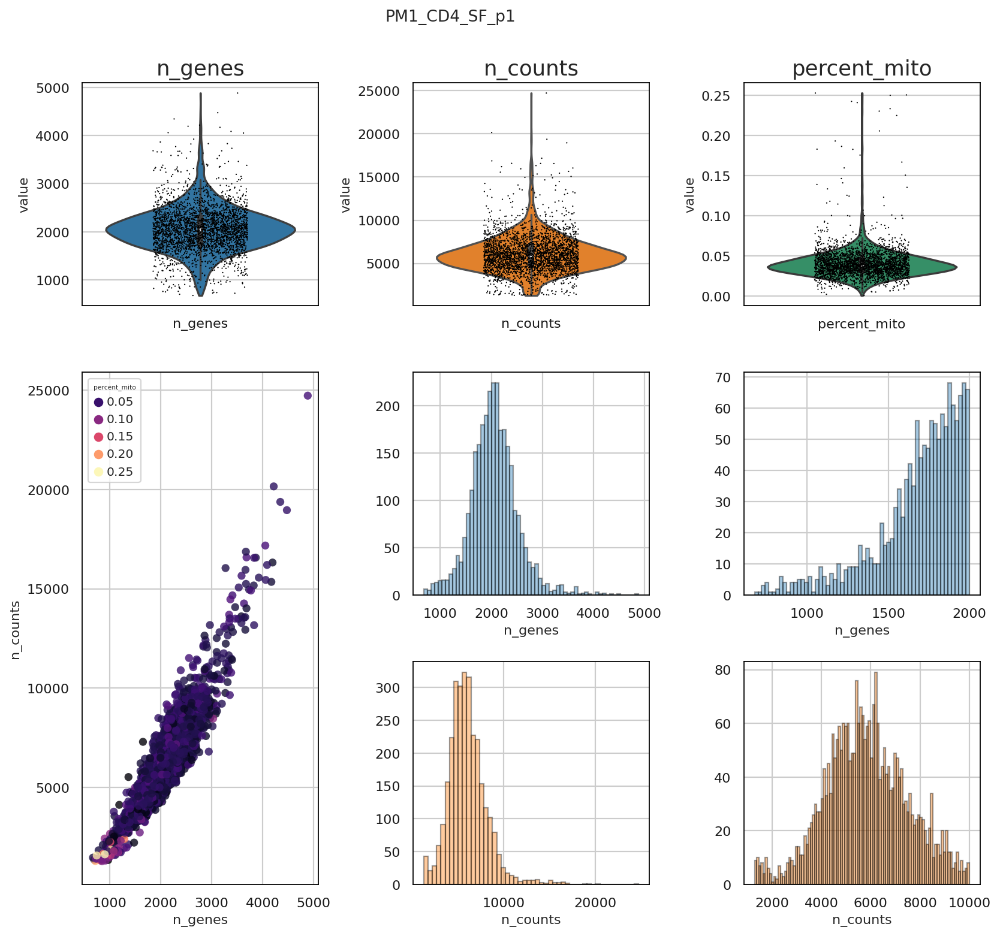

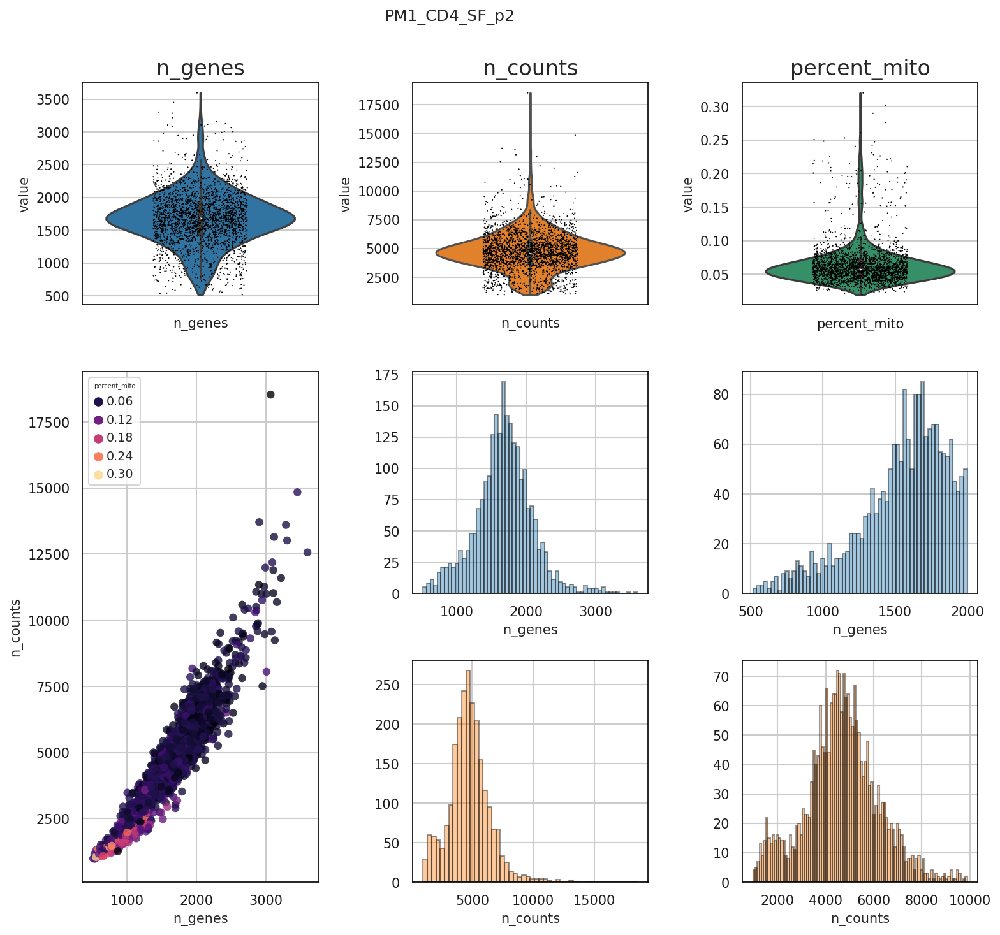

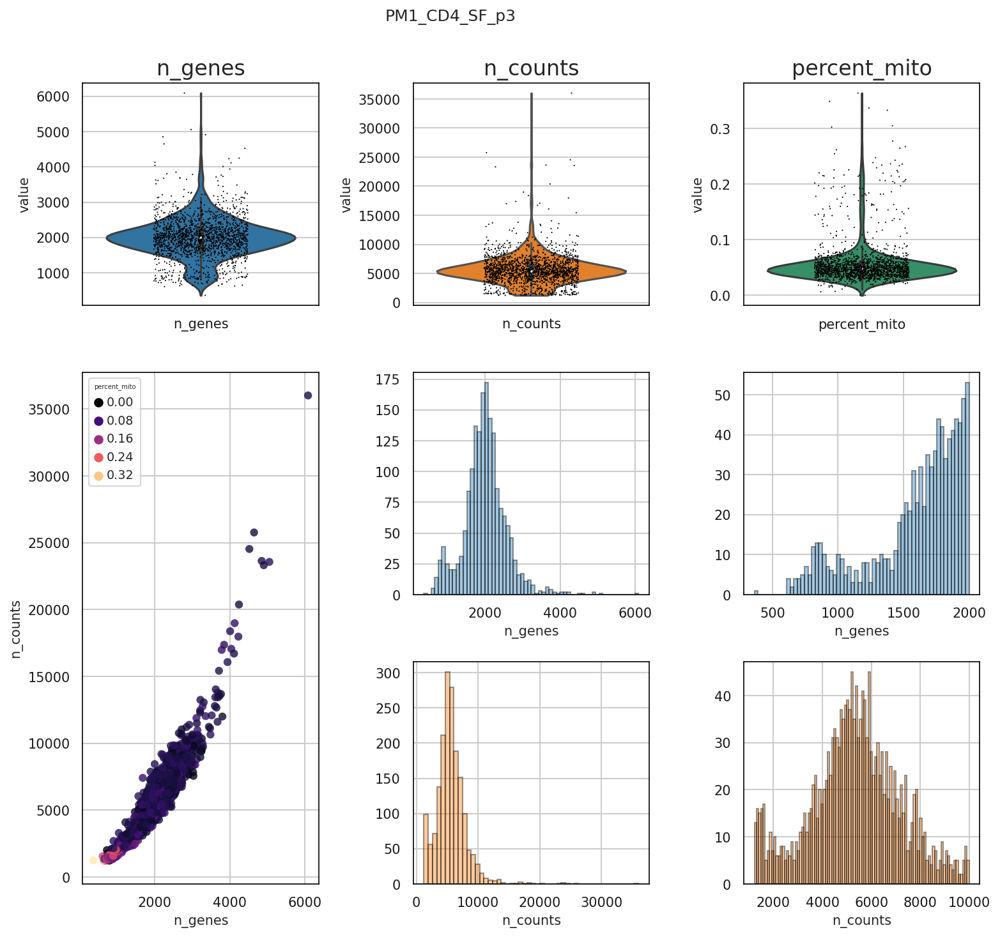

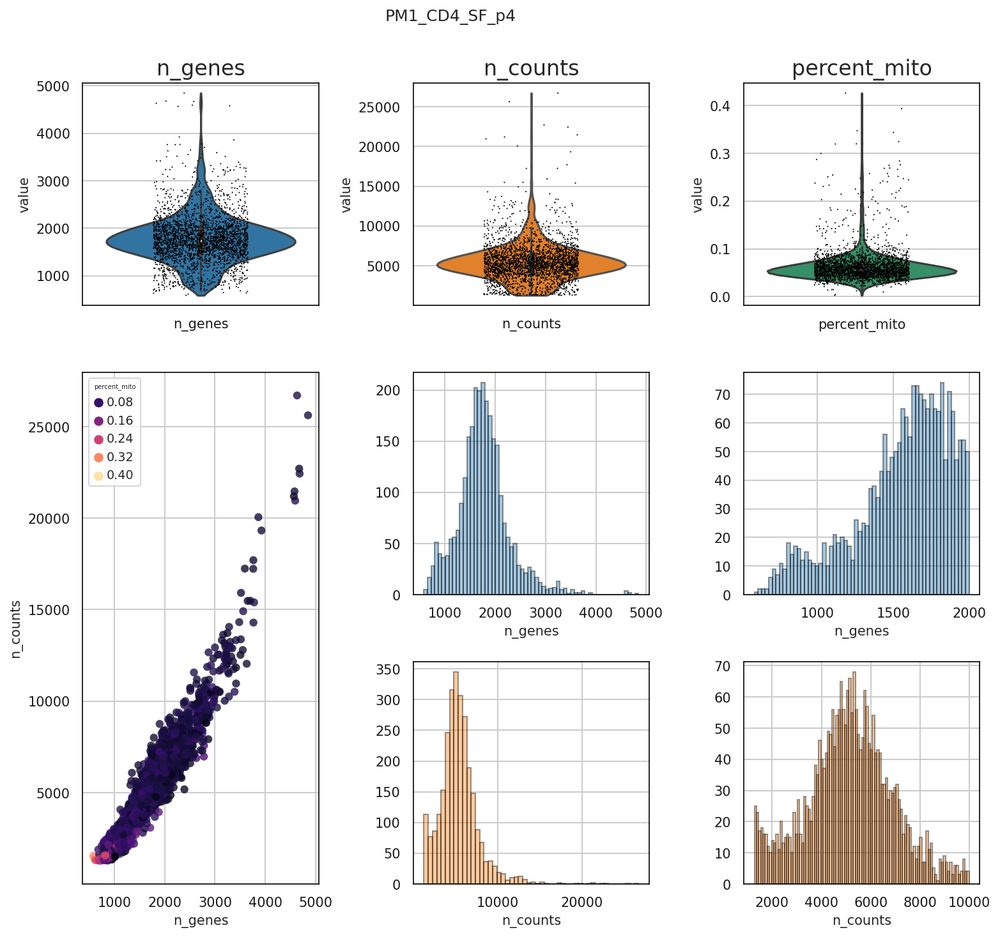

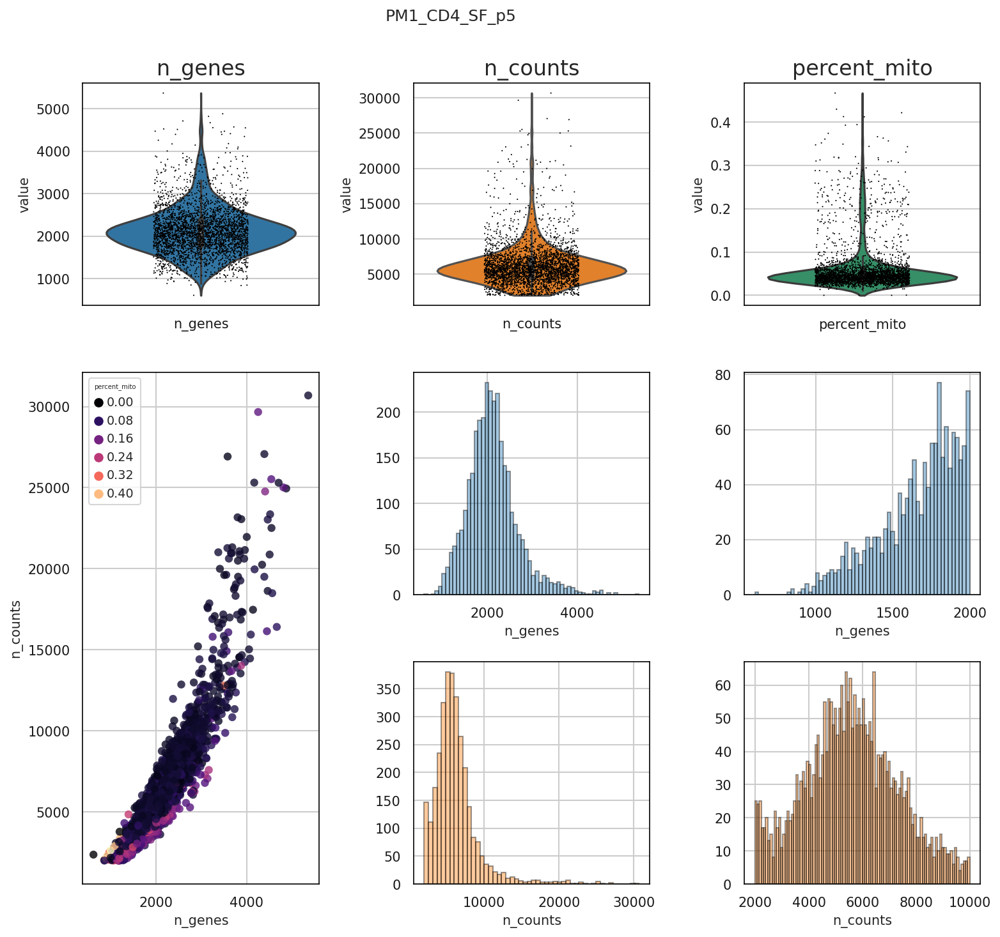

...

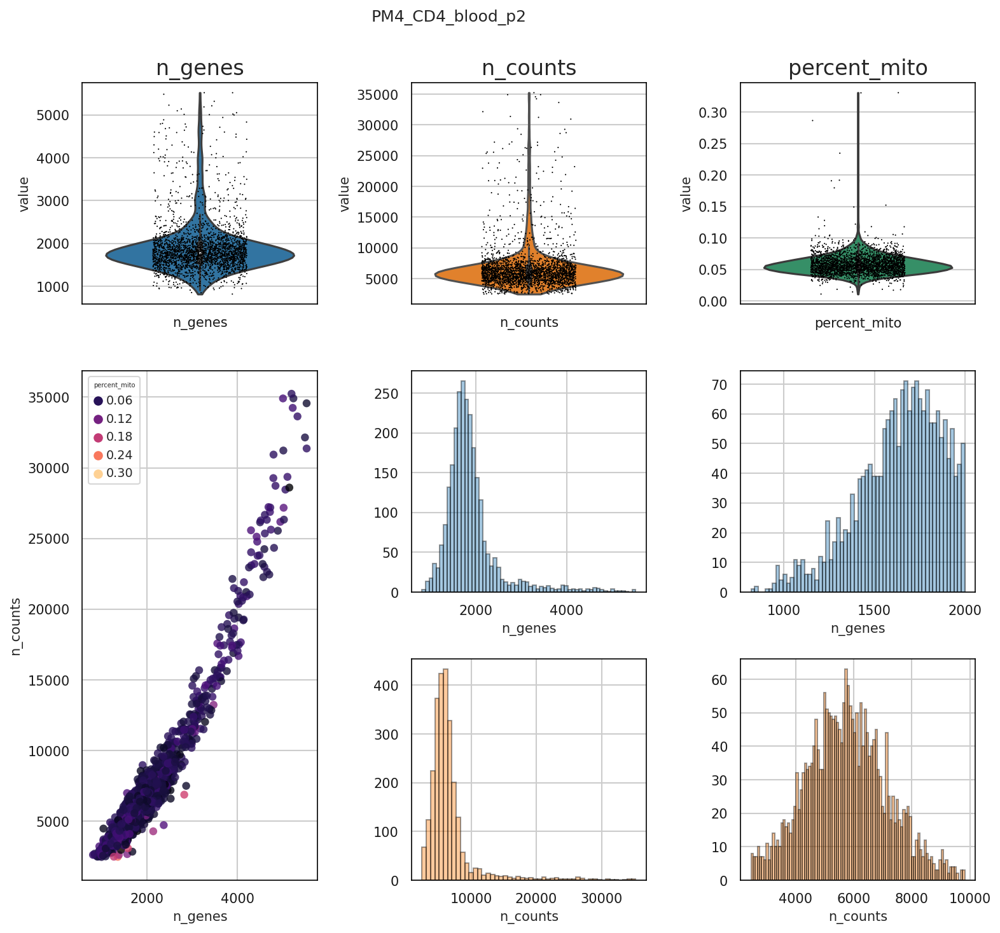

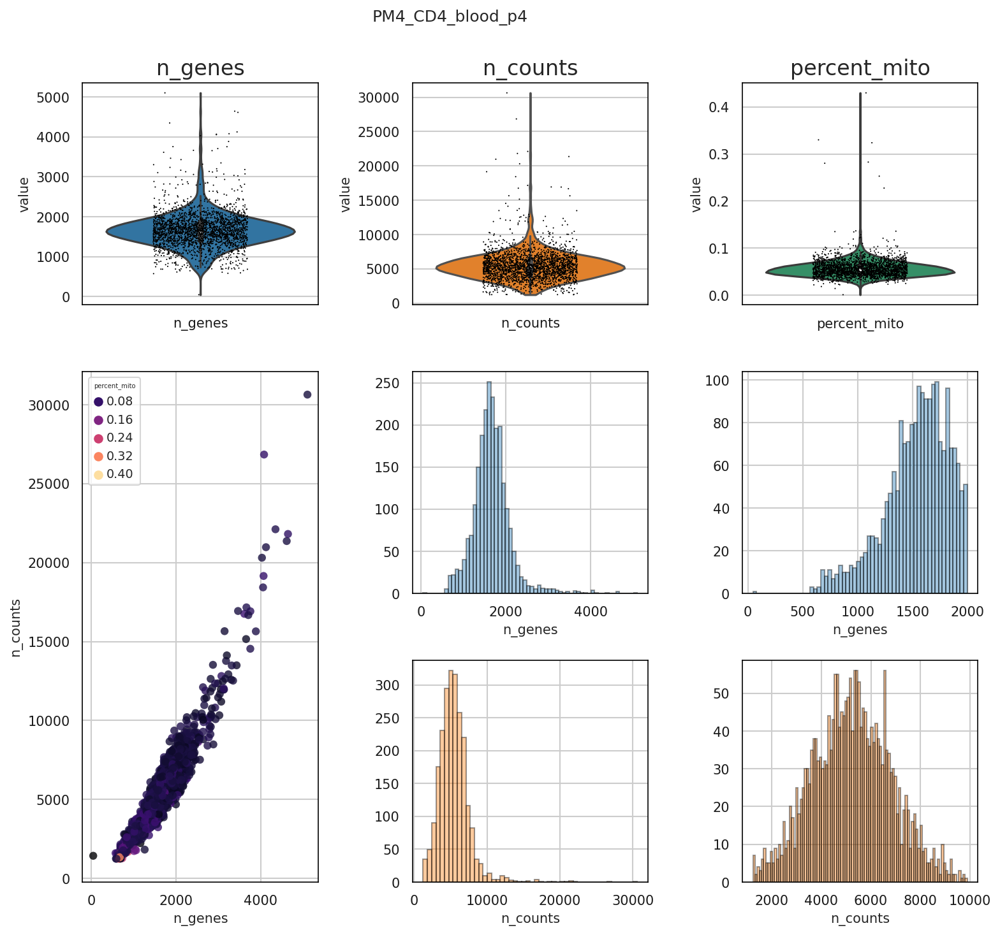

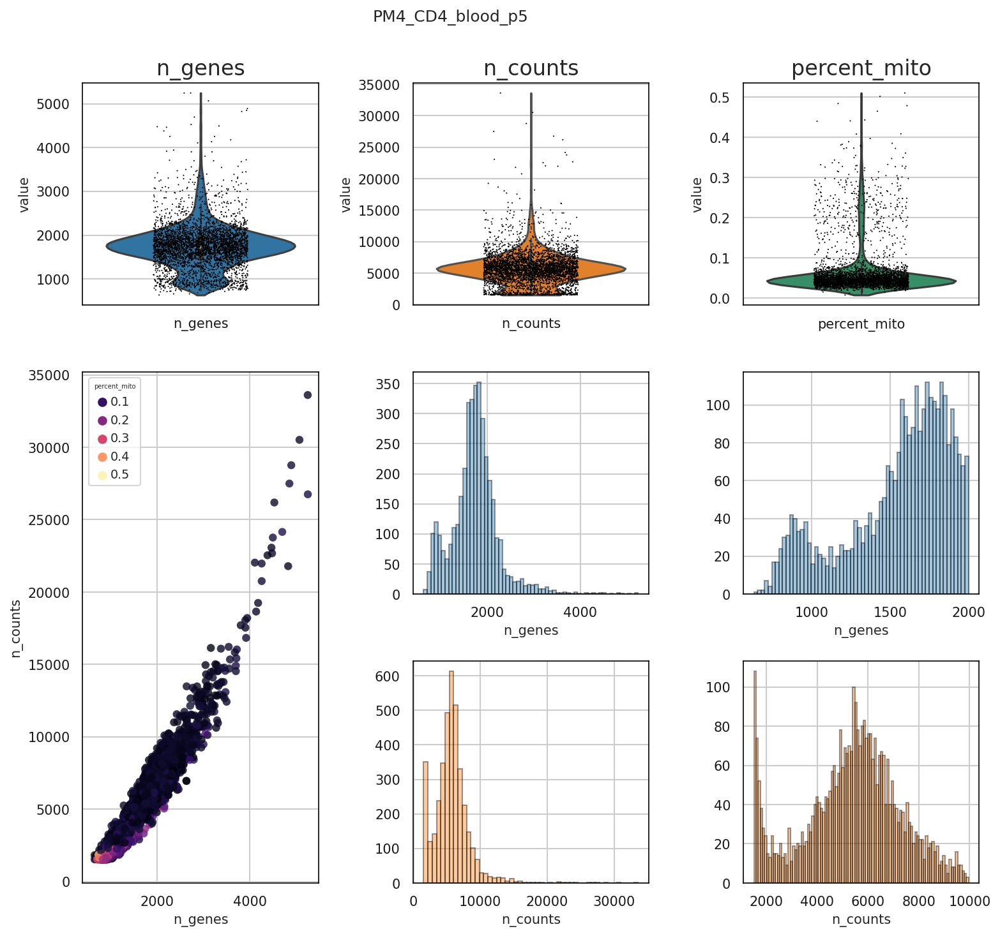

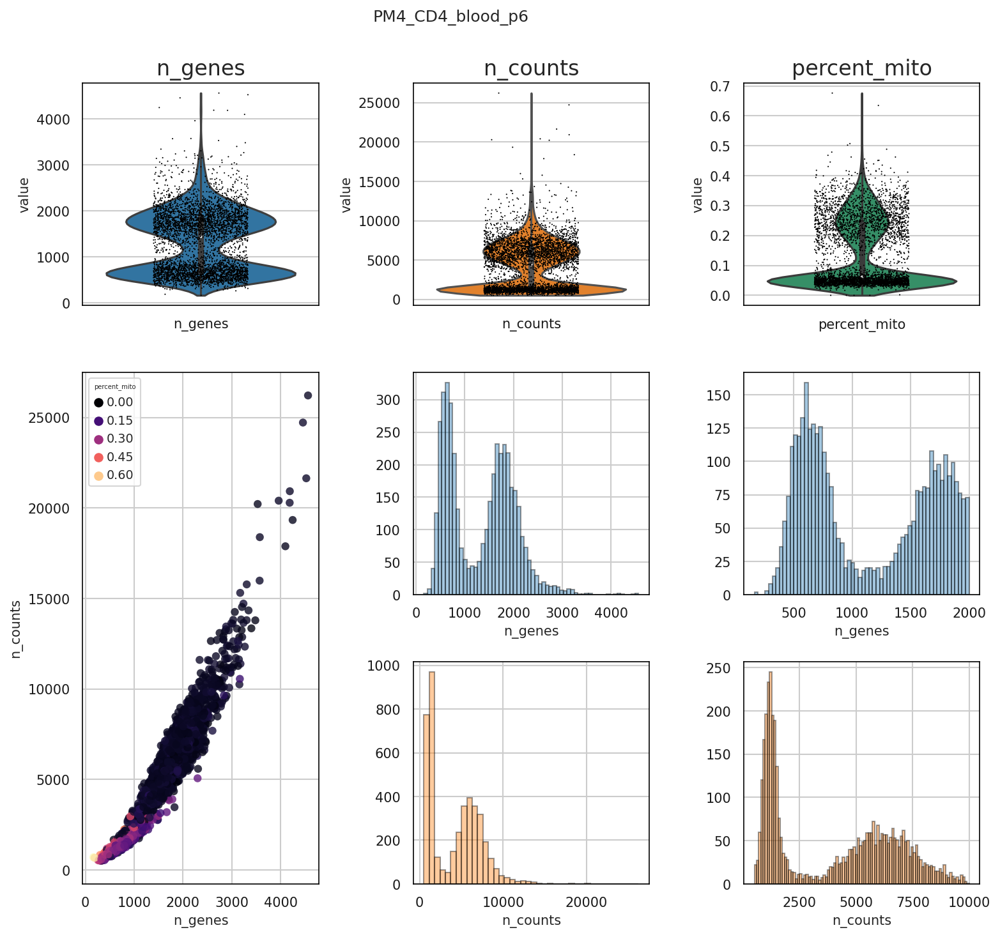

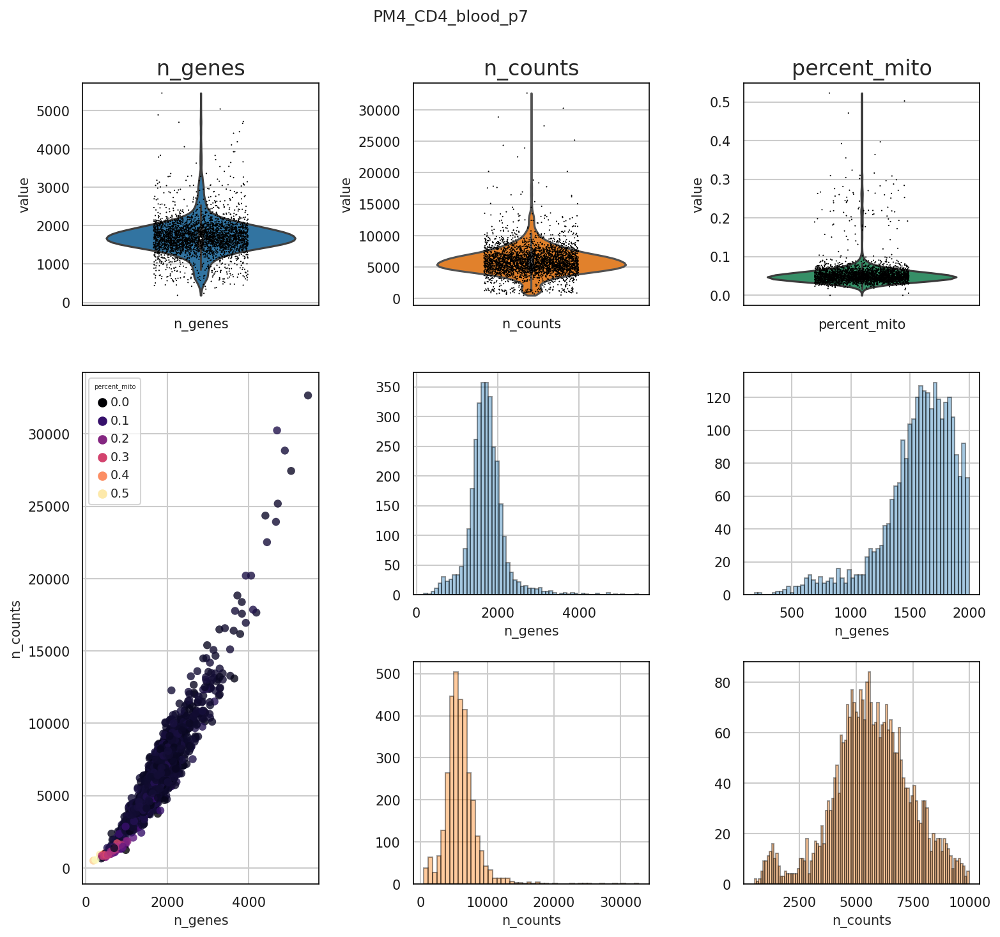

In [5]:
for adata, mod, tit in list(zip([PM1_CD4_SF_p1, PM1_CD4_SF_p2, PM1_CD4_SF_p3, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5, PM4_CD4_blood_p6, PM4_CD4_blood_p7],['human']*13, ['PM1_CD4_SF_p1', 'PM1_CD4_SF_p2', 'PM1_CD4_SF_p3', 'PM1_CD4_SF_p4', 'PM1_CD4_SF_p5', 'PM1_CD4_SF_p6', 'PM1_CD4_SF_p7', 'PM4_CD4_blood_p1', 'PM4_CD4_blood_p2', 'PM4_CD4_blood_p4', 'PM4_CD4_blood_p5', 'PM4_CD4_blood_p6', 'PM4_CD4_blood_p7'])):
    addQC2Adata(adata, mod)
    rcParams['patch.edgecolor']= 'black'
    fig = plt.figure(figsize=(12,11))
    gs = fig.add_gridspec(3,3, hspace=0.3, wspace=0.4)
    sc.set_figure_params(dpi=75, dpi_save=300, fontsize=10)
    fig.suptitle(tit)
    for i,n, c in zip(['n_genes', 'n_counts', 'percent_mito'], range(3), ['#1f77b4','#ff7f0e','#279e68']):
        ax1 = fig.add_subplot(gs[0, n])
        ax1_dict = sc.pl.violin(adata, i, jitter=0.2, ax=ax1, inner='box', color=c, show=False)
        ax1.set_title(i, size=16, loc='center')
        if n == 1:  
            ax2a = fig.add_subplot(gs[1, n])
            p6 = sb.distplot(adata.obs['n_genes'], kde=False, bins=60, ax=ax2a, color='#1f77b4')
            ax3a = fig.add_subplot(gs[2, n])
            p7 = sb.distplot(adata.obs['n_counts'], kde=False, ax=ax3a, color='#ff7f0e')
        if n == 2:
            ax2b = fig.add_subplot(gs[1, n])
            p8 = sb.distplot(adata.obs['n_genes'][adata.obs['n_genes']<2000], kde=False, bins=60, ax=ax2b, color='#1f77b4')
            ax3b = fig.add_subplot(gs[2, n])
            p9 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']<10000], kde=False, bins=100, ax=ax3b, color='#ff7f0e')        
    ax2 = fig.add_subplot(gs[1:, 0])
    ax2_dict = sb.scatterplot(data=adata.obs, x="n_genes", y="n_counts", hue="percent_mito", ax=ax2, palette='magma', alpha=0.8, linewidth=0)

In the following step we add some useful metadata to the dataset. 

In [6]:
filtered_ads = [PM1_CD4_SF_p1, PM1_CD4_SF_p2, PM1_CD4_SF_p3, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5, PM4_CD4_blood_p6, PM4_CD4_blood_p7]
str_filtered_ads = ['PM1_CD4_SF_p1', 'PM1_CD4_SF_p2', 'PM1_CD4_SF_p3', 'PM1_CD4_SF_p4', 'PM1_CD4_SF_p5', 'PM1_CD4_SF_p6', ' PM1_CD4_SF_p7', 'PM4_CD4_blood_p1', 'PM4_CD4_blood_p2', 'PM4_CD4_blood_p4', 'PM4_CD4_blood_p5', 'PM4_CD4_blood_p6', 'PM4_CD4_blood_p7']
for adata,name in zip(filtered_ads, str_filtered_ads):
    adata.obs['cell_type'] = ['CD4']*adata.shape[0]
    patient = name.split('_')[-1:]
    adata.obs['patient'] = patient*adata.shape[0]
    if 'SF' in name:
        adata.obs['sample_type'] = ['synovial fluid']*adata.shape[0]
    else:
        adata.obs['sample_type'] = ['blood']*adata.shape[0]

Next, we proceed with filtering basing on tresholds defined during quality check.

In [7]:
PM1_CD4_SF_p3_filt = filterData(PM1_CD4_SF_p3, min_genes=1250, max_genes=8000, min_counts=3000)
PM1_CD4_SF_p6_filt = filterData(PM1_CD4_SF_p6, min_genes=1250, max_genes=8000, min_counts=3000)
PM4_CD4_blood_p5_filt = filterData(PM4_CD4_blood_p5, min_genes=1250, max_genes=8000, min_counts=3000)
PM4_CD4_blood_p6_filt = filterData(PM4_CD4_blood_p6, min_genes=1250, max_genes=8000, min_counts=3000)

After filtering, we check filtered data. 

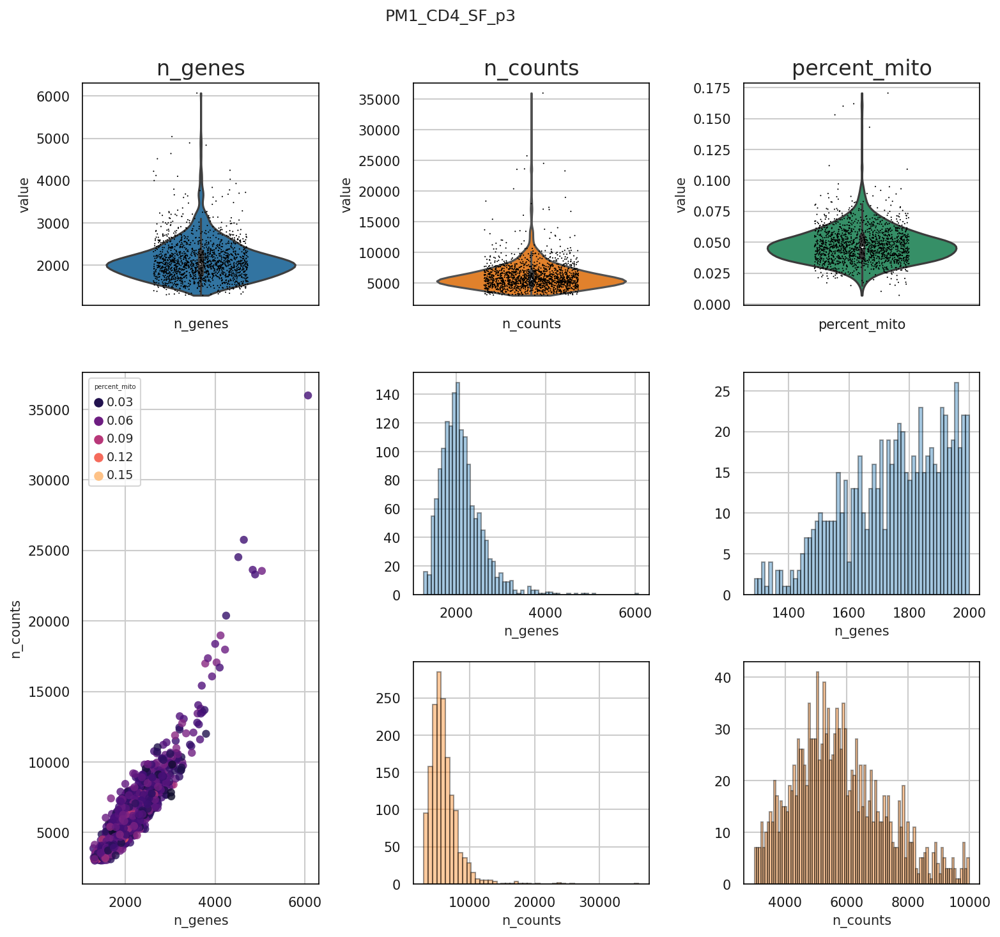

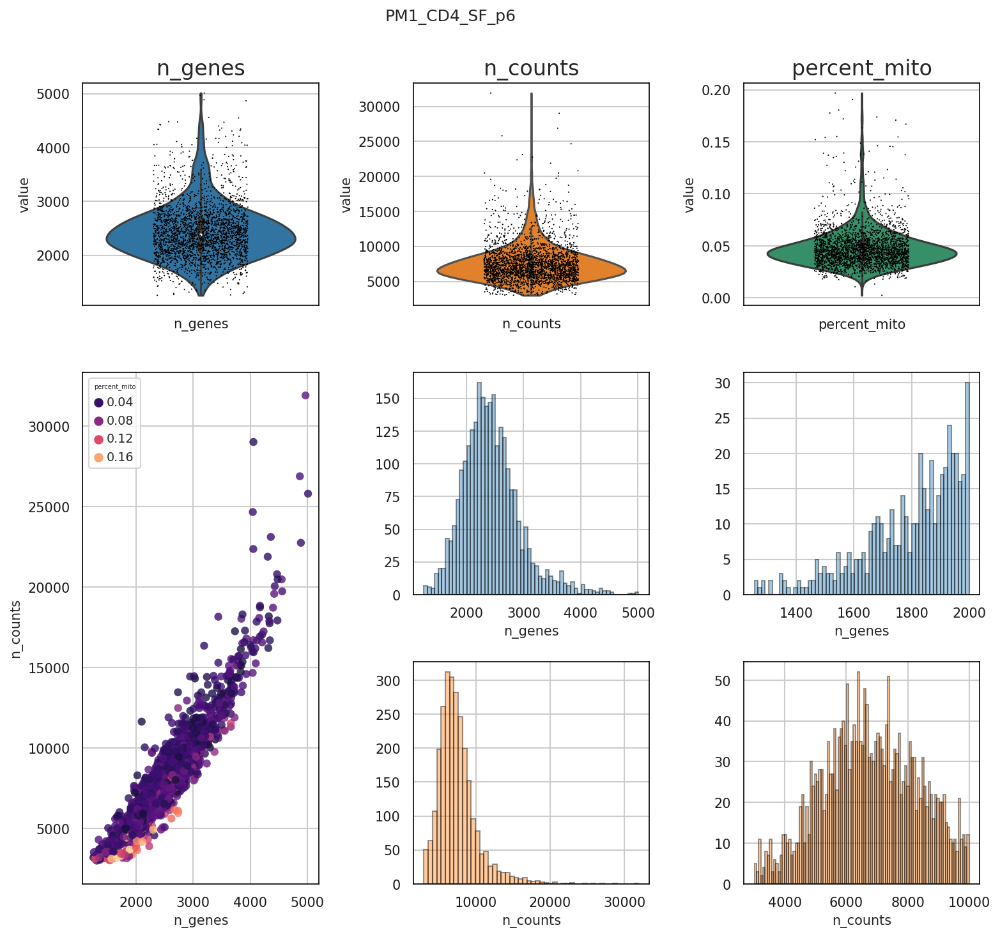

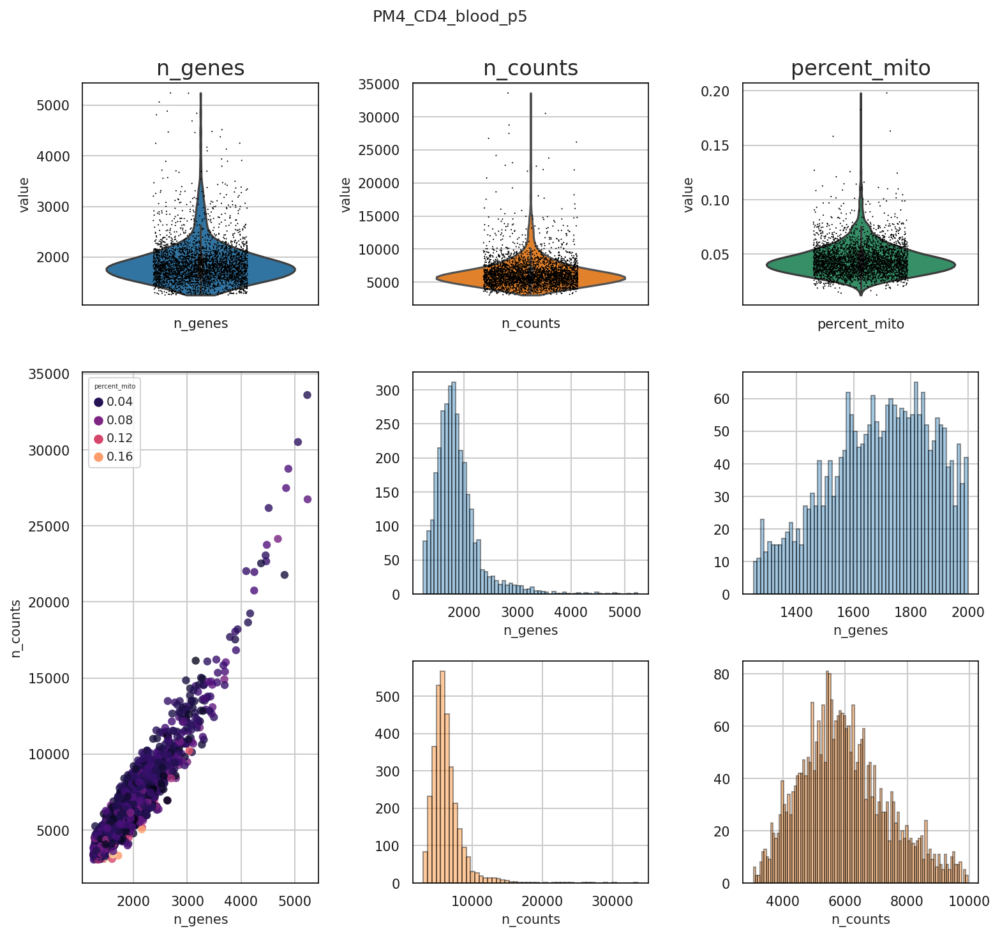

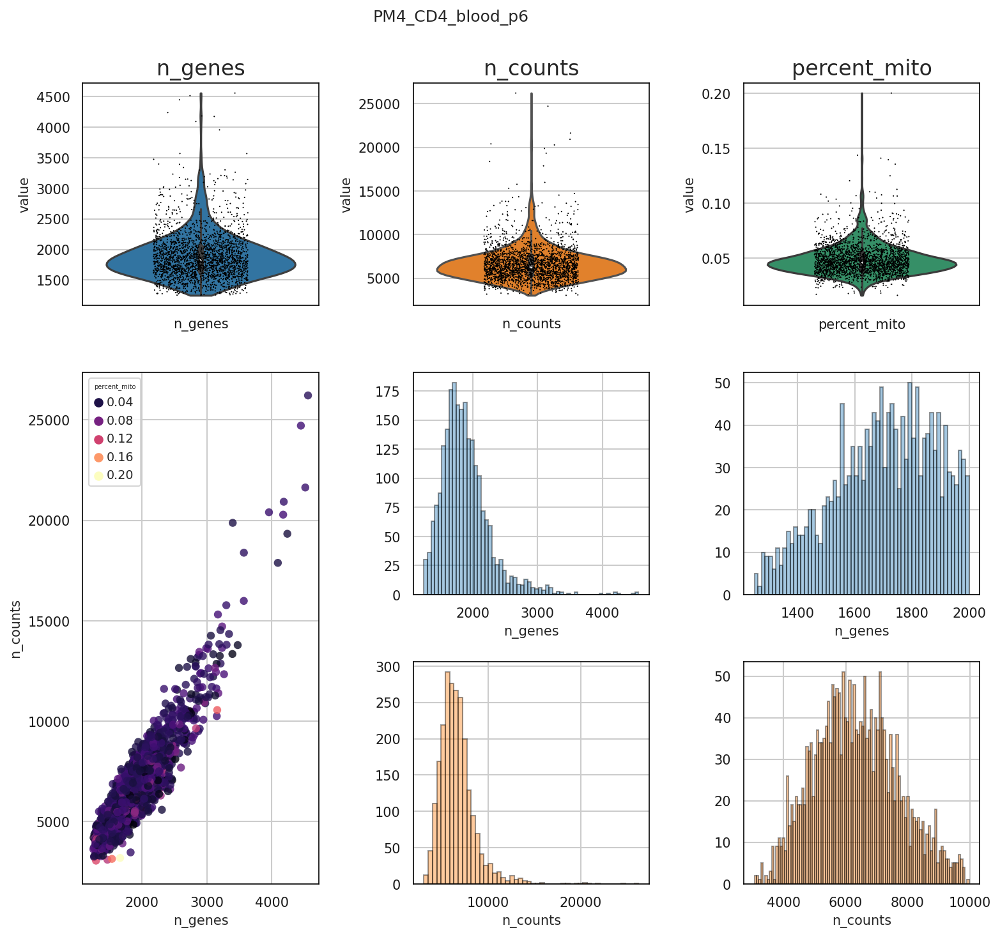

In [8]:
for adata, mod, tit in list(zip([PM1_CD4_SF_p3_filt, PM1_CD4_SF_p6_filt, PM4_CD4_blood_p5_filt, PM4_CD4_blood_p6_filt], ['human']*4, ['PM1_CD4_SF_p3', 'PM1_CD4_SF_p6', 'PM4_CD4_blood_p5', 'PM4_CD4_blood_p6'])):
    addQC2Adata(adata, mod)
    rcParams['patch.edgecolor']= 'black'
    fig = plt.figure(figsize=(12,11))
    gs = fig.add_gridspec(3,3, hspace=0.3, wspace=0.4)
    sc.set_figure_params(dpi=75, dpi_save=300, fontsize=10)
    fig.suptitle(tit)
    for i,n, c in zip(['n_genes', 'n_counts', 'percent_mito'], range(3), ['#1f77b4','#ff7f0e','#279e68']):
        ax1 = fig.add_subplot(gs[0, n])
        ax1_dict = sc.pl.violin(adata, i, jitter=0.2, ax=ax1, inner='box', color=c, show=False)
        ax1.set_title(i, size=16, loc='center')
        if n == 1:  
            ax2a = fig.add_subplot(gs[1, n])
            p6 = sb.distplot(adata.obs['n_genes'], kde=False, bins=60, ax=ax2a, color='#1f77b4')
            ax3a = fig.add_subplot(gs[2, n])
            p7 = sb.distplot(adata.obs['n_counts'], kde=False, ax=ax3a, color='#ff7f0e')
        if n == 2:
            ax2b = fig.add_subplot(gs[1, n])
            p8 = sb.distplot(adata.obs['n_genes'][adata.obs['n_genes']<2000], kde=False, bins=60, ax=ax2b, color='#1f77b4')
            ax3b = fig.add_subplot(gs[2, n])
            p9 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']<10000], kde=False, bins=100, ax=ax3b, color='#ff7f0e')        
    ax2 = fig.add_subplot(gs[1:, 0])
    ax2_dict = sb.scatterplot(data=adata.obs, x="n_genes", y="n_counts", hue="percent_mito", ax=ax2, palette='magma', alpha=0.8, linewidth=0)

After filtering we retain 33217 cells distributed as below.

In [9]:
totcells=[]
for i in [PM1_CD4_SF_p1,PM1_CD4_SF_p2, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6_filt, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5_filt, PM4_CD4_blood_p6_filt, PM4_CD4_blood_p7]:
    totcells.append(len(i.obs_names))
pd.DataFrame(totcells).T

,0,1,2,3,4,5,6,7,8,9,10,11
0,2942,2368,2726,3132,2619,2757,2961,2611,2324,3241,2326,3210


Next, we use the tool scrublet to indetify and mark potential dublets.

In [10]:
for i in [PM1_CD4_SF_p1, PM1_CD4_SF_p2, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6_filt, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5_filt, PM4_CD4_blood_p6_filt, PM4_CD4_blood_p7]:
    scr_doublets(i, rate=0.05)

Sample doublets rate: 0.001699524133242692
Sample doublets rate: 0.0071790540540540545
Sample doublets rate: 0.0011005135730007337
Sample doublets rate: 0.0028735632183908046
Sample doublets rate: 0.0007636502481863307
Sample doublets rate: 0.0018135654697134566
Sample doublets rate: 0.0013508949679162446
Sample doublets rate: 0.0007659900421294523
Sample doublets rate: 0.0034423407917383822
Sample doublets rate: 0.0015427337241592102
Sample doublets rate: 0.0017196904557179708
Sample doublets rate: 0.007476635514018692


The doublet rate per sample is small (>0.005) for almost al samples.

## 3. Normalization

Next, we prepare data for normalization and batch correction via Mutual Nearest Neighbor (MNN) algorithm.

Downstream methods require the presence of same genes in the datasets, therefore we excluded genes present only in a sample and not in others.

To assess the impact of their removal, we counted the number of cells affected by it (i.e. the cells expressing these genes). The histogram below reports the distribution of the number of cells expressing genes to be removed. The vast majority of these genes are expressed in a low number of cells, meaning that their removal has a low impact.

After removing these genes, the datasets are merged in a single dataframe.

In [11]:
for i in [PM1_CD4_SF_p1,PM1_CD4_SF_p2, PM1_CD4_SF_p3_filt, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6_filt, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5_filt, PM4_CD4_blood_p6_filt, PM4_CD4_blood_p7]:
    i.var['n_cells'] = pd.DataFrame(i.X.todense()).astype(bool).sum(axis=0).to_list()

In [12]:
filtered_ads = [PM1_CD4_SF_p1, PM1_CD4_SF_p2, PM1_CD4_SF_p4, PM1_CD4_SF_p5, PM1_CD4_SF_p6_filt, PM1_CD4_SF_p7, PM4_CD4_blood_p1, PM4_CD4_blood_p2, PM4_CD4_blood_p4, PM4_CD4_blood_p5_filt, PM4_CD4_blood_p6_filt, PM4_CD4_blood_p7]
filtered_genes = []
for ad_ in filtered_ads:
    filtered_genes.append(set(ad_.var.index))

In [13]:
further_filtering = {}
shared = set.intersection(*filtered_genes)

Text(0.5, 1.0, 'Distribution of `Number of cells` in which the genes to-be-removed are expressed')

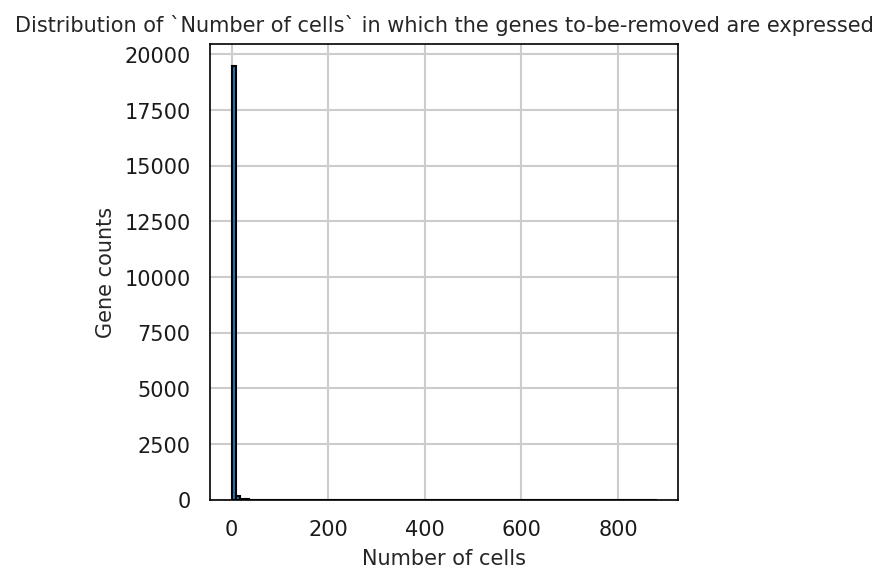

In [14]:
for i,s in enumerate(filtered_genes):
    uniq = s.difference(shared)
    further_filtering.update(filtered_ads[i].var["n_cells"][list(uniq)].to_dict())
plt.hist(further_filtering.values(),bins=100)
plt.xlabel('Number of cells')
plt.ylabel('Gene counts')
plt.title('Distribution of `Number of cells` in which the genes to-be-removed are expressed')

In [15]:
# remove genes present only in one dataset
PM1_CD4_SF_p1_final = PM1_CD4_SF_p1[:,~PM1_CD4_SF_p1.var.index.isin(further_filtering)]
PM1_CD4_SF_p2_final = PM1_CD4_SF_p2[:,~PM1_CD4_SF_p2.var.index.isin(further_filtering)]
PM1_CD4_SF_p4_final = PM1_CD4_SF_p4[:,~PM1_CD4_SF_p4.var.index.isin(further_filtering)]
PM1_CD4_SF_p5_final = PM1_CD4_SF_p5[:,~PM1_CD4_SF_p5.var.index.isin(further_filtering)]
PM1_CD4_SF_p6_filt_final = PM1_CD4_SF_p6_filt[:,~PM1_CD4_SF_p6_filt.var.index.isin(further_filtering)]
PM1_CD4_SF_p7_final = PM1_CD4_SF_p7[:,~PM1_CD4_SF_p7.var.index.isin(further_filtering)]
PM4_CD4_blood_p1_final = PM4_CD4_blood_p1[:,~PM4_CD4_blood_p1.var.index.isin(further_filtering)]
PM4_CD4_blood_p2_final = PM4_CD4_blood_p2[:,~PM4_CD4_blood_p2.var.index.isin(further_filtering)]
PM4_CD4_blood_p4_final = PM4_CD4_blood_p4[:,~PM4_CD4_blood_p4.var.index.isin(further_filtering)]
PM4_CD4_blood_p5_filt_final = PM4_CD4_blood_p5_filt[:,~PM4_CD4_blood_p5_filt.var.index.isin(further_filtering)]
PM4_CD4_blood_p6_filt_final = PM4_CD4_blood_p6_filt[:,~PM4_CD4_blood_p6_filt.var.index.isin(further_filtering)]
PM4_CD4_blood_p7_final = PM4_CD4_blood_p7[:,~PM4_CD4_blood_p7.var.index.isin(further_filtering)]
ads_final = [PM1_CD4_SF_p1_final, PM1_CD4_SF_p2_final, PM1_CD4_SF_p4_final, PM1_CD4_SF_p5_final, PM1_CD4_SF_p6_filt_final, PM1_CD4_SF_p7_final, PM4_CD4_blood_p1_final, PM4_CD4_blood_p2_final, PM4_CD4_blood_p4_final, PM4_CD4_blood_p5_filt_final, PM4_CD4_blood_p6_filt_final, PM4_CD4_blood_p7]
for dsname,ad_ in zip(['PM1_CD4_SF_p1', 'PM1_CD4_SF_p2', 'PM1_CD4_SF_p4', 'PM1_CD4_SF_p5', 'PM1_CD4_SF_p6', ' PM1_CD4_SF_p7', 'PM4_CD4_blood_p1', 'PM4_CD4_blood_p2', 'PM4_CD4_blood_p4', 'PM4_CD4_blood_p5', 'PM4_CD4_blood_p6', 'PM4_CD4_blood_p7'],ads_final):
    ad_.obs['dataset'] = [dsname]*ad_.n_obs
adata_final = ads_final[0].concatenate(ads_final[1:])

Up to this point the data is only available as a count matrix. Counts are representative of molecules that were captured in the scRNA-seq experiment. As not all mRNA molecules in a cell are captured, there is a variability in the total number of counts detected between cells that results from both the number of molecules that were in the cells, and the sampling. As we cannot assume that all cells contain an equal number of molecules (cell sizes can differ substantially), we have to estimate the number of molecules that were initially in the cells. In fact, we don't estimate the exact number of molecules, but instead estimate cell-specific factors that should be proportional to the true number of molecules. These are called size factors. Normalized expression values are calculated by dividing the measured counts by the size factor for the cell.

To perform nomalization we use scran package. This method requires a coarse clustering input to improve size factor esimation performance. Thus, we use a simple preprocessing approach and cluster the data at a low resolution to get an input for the size factor estimation. The basic preprocessing includes assuming all size factors are equal (library size normalization to counts per million - CPM) and log-transforming the count data.

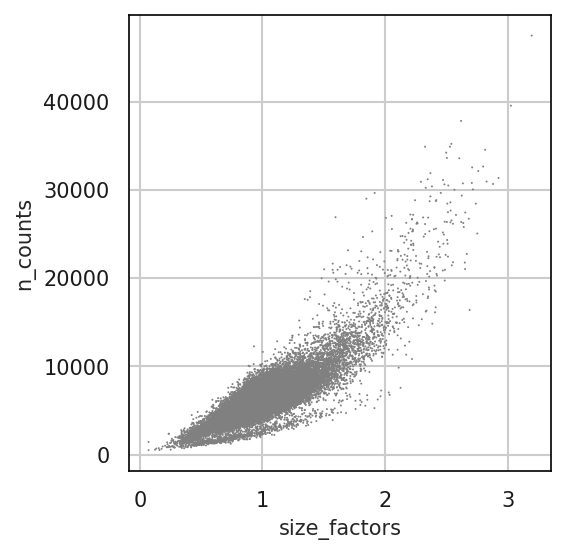

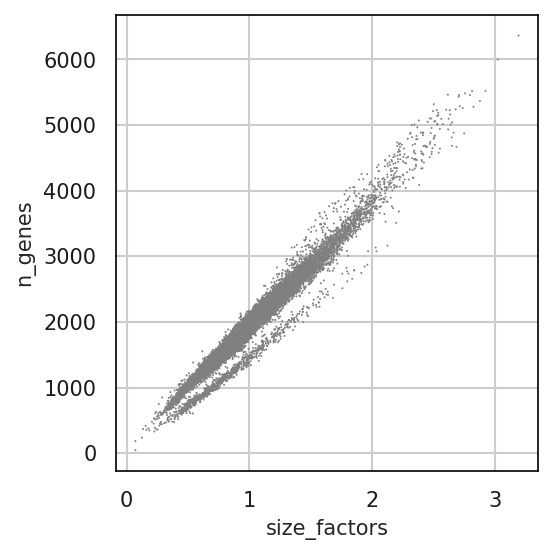

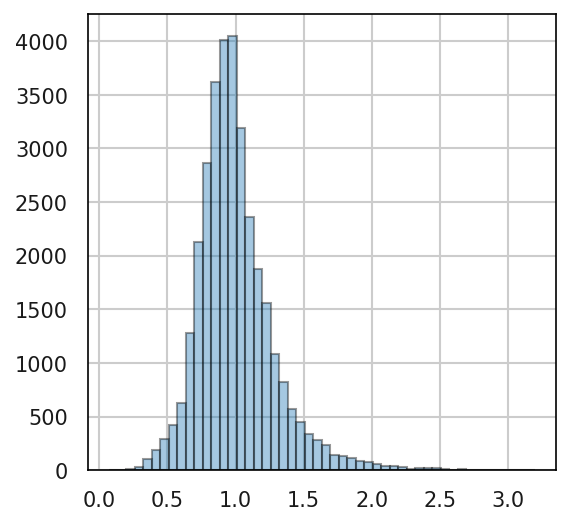

In [16]:
sc_normalization(adata_final, counts=1e6)
sc.pp.log1p(adata_final)
adata_final.layers["norm_log2_counts"] = adata_final.X.copy()
adata_final.raw = adata_final

In [17]:
adata_final.write('CD4_nm.h5ad')

## 4. Batch Correction

#### Dataset integration with MNN

Matching Mutual Nearest Neighbors (MNN) is a statistical technique used to minimize technical differences in gene expression due to different experiments (aka dataset integration). Here we apply such approach to minimize technical differences between datasets used and to infer populations structure and differentially-expressed genes.

The workflow we will be using for our analysis is the following:

- Identification of Highly Variable Genes (HVGs)
- Dataset integration with MNN

#### Identification of Highly Variable Genes (HGVs)

Some mathematical analyses (such as UMAP) greatly benefit from before-hand feature selection to remove computational burden and noise sources. Therefore, it is a common procedure to select a set (in the range of 0.5-5k) of Highly Variable Genes (HVGs).

For our specific case, MNN authors recommend to apply their methods on a selection of HVGs. I will be using the method implemented in scanpy (highly_variable_genes) to perform such task, which will add a True/False flag to the genes to indicate if they are in the top z variable genes. Note that here we aim at finding the top shared 1k variable genes. The highly_variable_genes method allows to pass a key indicating the batch factor, which I will be using to indicating the dataset origin. With this option, the method will add to the adata.var dataframe a boolean flag indicating if a given gene is a HVG for all the datasets (column name is highly_variable_intersection).


In [18]:
sc.pp.highly_variable_genes(adata_final,n_top_genes=4000, batch_key='batch')

In [19]:
adata_final.var[adata_final.var["highly_variable"]]
sum(adata_final.var["highly_variable_intersection"])
hvgs = adata_final.var[adata_final.var["highly_variable_intersection"]].index.values

In [20]:
spliced = [adata_final[adata_final.obs["dataset"]==x,:].copy() for x in ['PM1_CD4_SF_p1', 'PM1_CD4_SF_p2', 'PM1_CD4_SF_p4', 'PM1_CD4_SF_p5', 'PM1_CD4_SF_p6', ' PM1_CD4_SF_p7', 'PM4_CD4_blood_p1', 'PM4_CD4_blood_p2', 'PM4_CD4_blood_p4', 'PM4_CD4_blood_p5', 'PM4_CD4_blood_p6', 'PM4_CD4_blood_p7']]

In [21]:
mnn_corrected = sc.external.pp.mnn_correct(*spliced, 
                              var_subset=hvgs,
                              k=20,
                              batch_key='dataset',
                              batch_categories = ['PM1_CD4_SF_p1', 'PM1_CD4_SF_p2', 'PM1_CD4_SF_p4', 'PM1_CD4_SF_p5', 'PM1_CD4_SF_p6', ' PM1_CD4_SF_p7', 'PM4_CD4_blood_p1', 'PM4_CD4_blood_p2', 'PM4_CD4_blood_p4', 'PM4_CD4_blood_p5', 'PM4_CD4_blood_p6', 'PM4_CD4_blood_p7'], n_jobs=150)

Performing cosine normalization...
Starting MNN correct iteration. Reference batch: 0
Step 1 of 11: processing batch 1
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 2 of 11: processing batch 2
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 3 of 11: processing batch 3
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 4 of 11: processing batch 4
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 5 of 11: processing batch 5
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 6 of 11: processing batch 6
  Looking for MNNs...
  Computing correction vectors...
  Adjusting variance...
  Applying correction...
Step 7 of 11: processing batch 7
  Looking for MNNs...
  Computing correction vectors.

After HVGs, MNN correction is computed (above) and plotted before/after correction (below), with cells color labelled according to dataset of origin.

In [22]:
mnn_corrected[0].write('CD4_no_bc.h5ad')

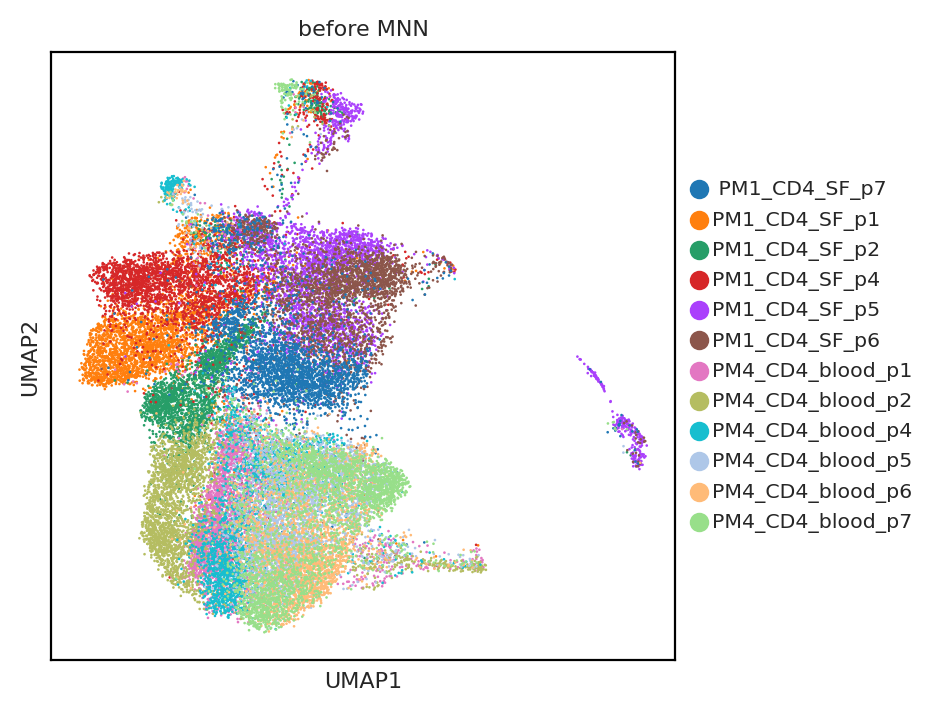

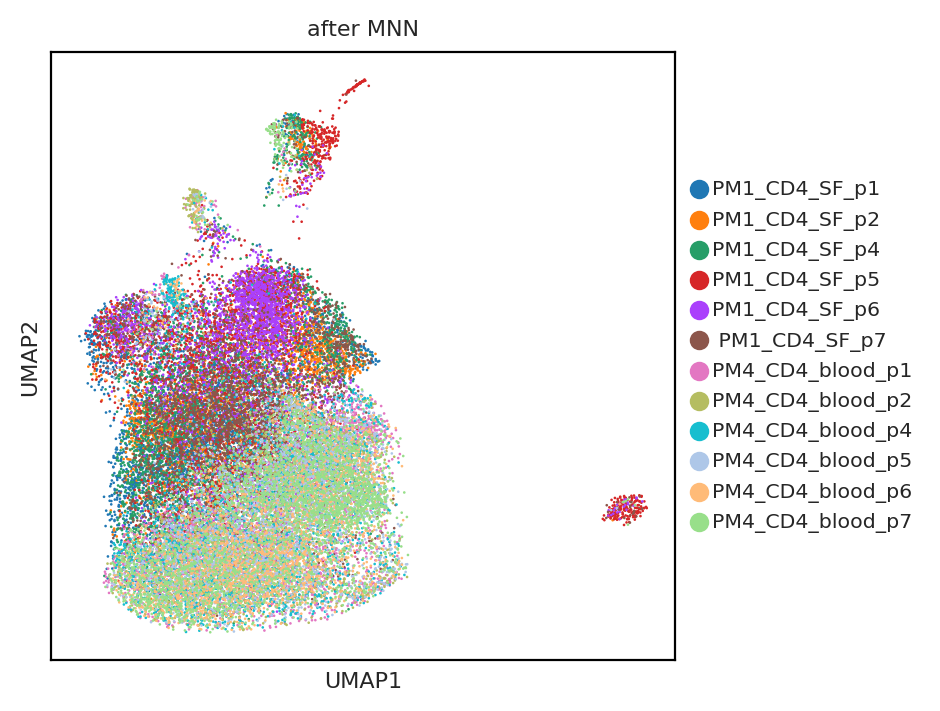

In [23]:
sc.pp.pca(adata_final)
sc.pp.neighbors(adata_final)
sc.tl.umap(adata_final)
if type(mnn_corrected) == tuple: mnn_corrected = mnn_corrected[0]
sc.pp.pca(mnn_corrected)
sc.pp.neighbors(mnn_corrected)
sc.tl.umap(mnn_corrected)
mnn_corrected.uns['batch_colors'] = ['#7570b3', '#d95f02', '#e6ab02', '#1b9e77']
mnn_corrected.uns['dataset_colors'] = ['#7570b3', '#d95f02', '#e6ab02', '#1b9e77']
sc.pl.umap(adata_final, color='dataset',title="before MNN")
sc.pl.umap(mnn_corrected, color='dataset',title="after MNN")

## 5. Visualization

In this section we compute data visualizations and add some other metadata.

In [24]:
calculate_visulizations(mnn_corrected, components_n=50, th=150)

In [25]:
mnn_corrected.write('CD4_no_bc_v.h5ad')

In [26]:
old_to_new = {'blood':'PB', 'synovial fluid':'SF'}
mnn_corrected.obs['sample_type'] = (
    mnn_corrected.obs['sample_type']
    .map(old_to_new)
    .astype('category')
)

In [27]:
mnn_corrected.obs['pm'] = list(map(lambda x:x.split('-')[3], mnn_corrected.obs.dataset.index.to_list()))
mnn_corrected.obs['pm_only'] = list(map(lambda x:x.split('_')[0], mnn_corrected.obs.pm.to_list()))

In [28]:
out_list = []
for lines in mnn_corrected.obs['cell_type'].cat.categories.to_list():
    a = mnn_corrected.obs['cell_type'][mnn_corrected.obs['cell_type'] == lines]
    for n in a.index.to_list():
        if 'SF' in n:
            out_list.append([n, lines + ' SF'])
        else:
            out_list.append([n, lines + ' PB'])            
mnn_corrected.obs['cell type/sample'] = pd.DataFrame(out_list).set_index(0).reindex(mnn_corrected.obs.index).squeeze()

In [29]:
mnn_corrected.uns['cell type/sample_colors'] = ['#98df8a', '#d62728']
mnn_corrected.uns['sample_type_colors'] = ['#98df8a', '#d62728']

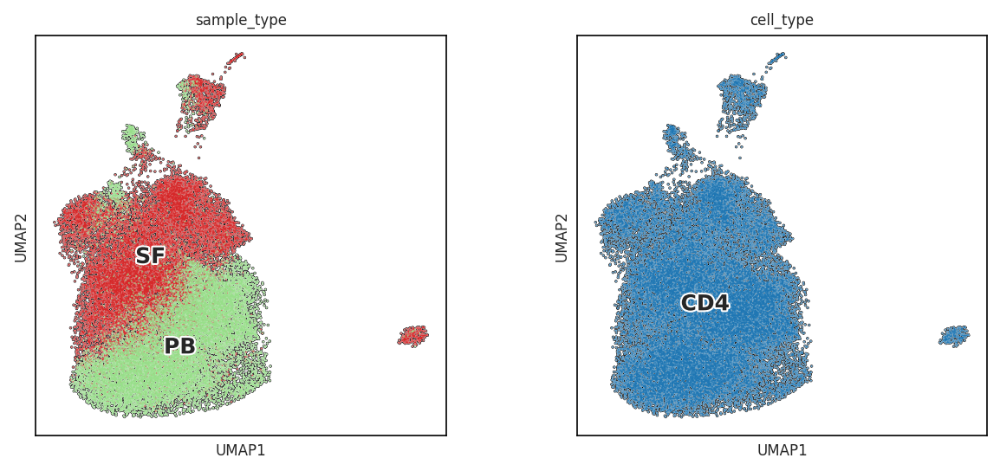

In [30]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=8, vector_friendly=False, format='png', figsize=(4,4))
sc.pl.umap(mnn_corrected, color=['sample_type', 'cell_type'], add_outline=True, legend_loc='on data', legend_fontsize=12, legend_fontoutline=2, wspace=0.2, save='Tcell_CD4.png')

The dataset now contains:
- a 'counts' layer with count data
- log-normalized data in adata.raw
- batch corrected data in adata.X

## 6. Cell Cycle

 A known source of biological variation that can explain the data is the cell cycle. Here, a gene list from [Tirosh et al, 2015](https://www.science.org/doi/10.1126/science.aad0501) is used to score the cell cycle effect in the data and classify cells by cell cycle phase. The file can be found on the single-cell-tutorial github repository. 

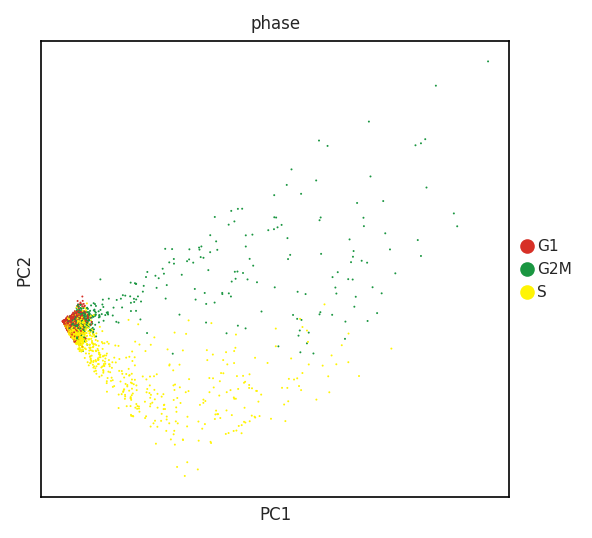

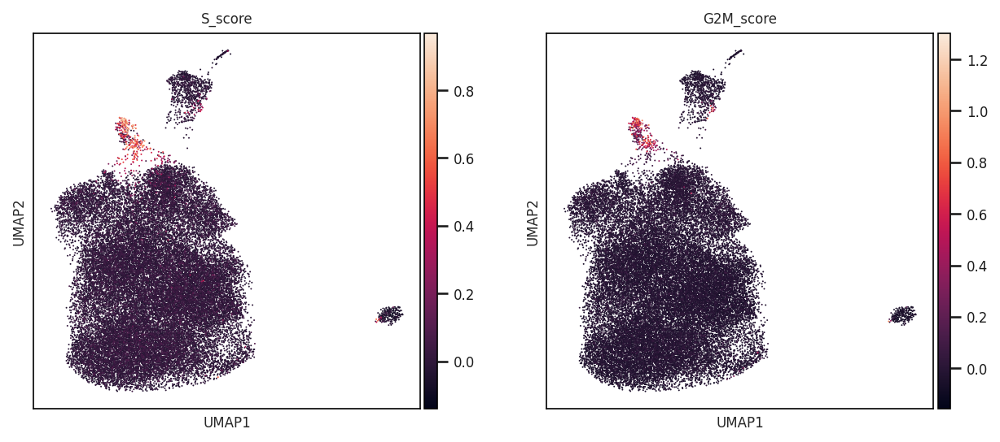

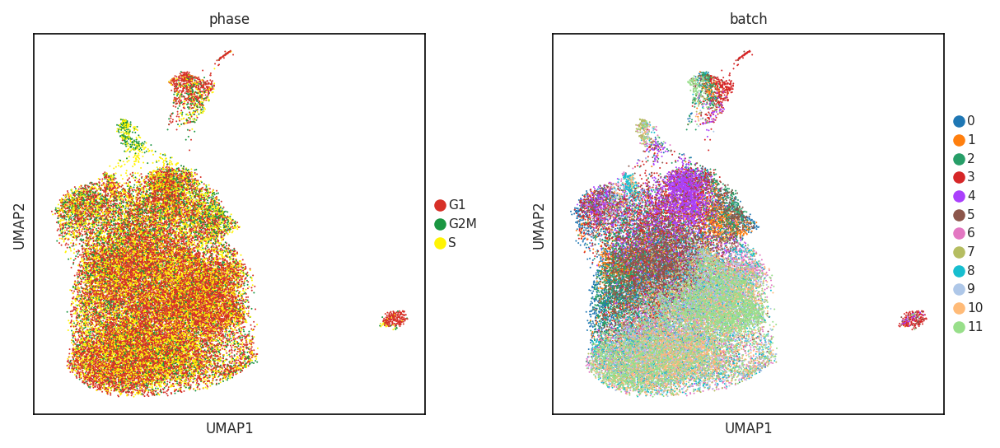

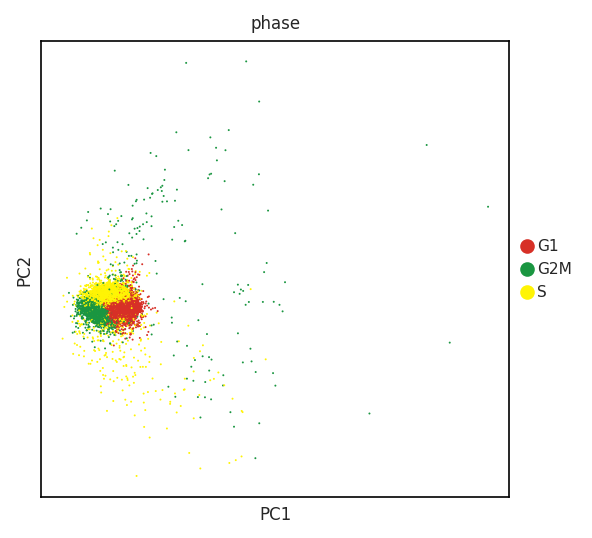

In [31]:
mnn_corrected = cell_cycle_info(mnn_corrected, 'human')

## 7. Downstream analysis

### 7.1 Clustering
Clustering is a central component of the scRNA-seq analysis pipeline. To understand the data, we must identify cell types and states present. Here, we perform clustering at three resolutions. Investigating several resolutions allows us to select a clustering that appears to capture the main clusters in the visualization and can provide a good baseline for further subclustering of the data to identify more specific substructure.

In [32]:
sc.tl.louvain(mnn_corrected, key_added='louvain_r1')
sc.tl.louvain(mnn_corrected, resolution=0.7, key_added='louvain_r0.7')
sc.tl.louvain(mnn_corrected, resolution=0.5, key_added='louvain_r0.5')

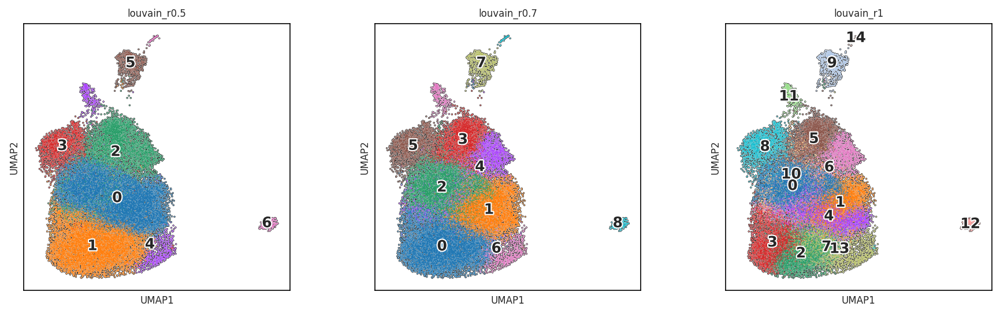

In [33]:
sc.pl.umap(mnn_corrected, color=['louvain_r0.5', 'louvain_r0.7', 'louvain_r1'], add_outline=True, legend_loc='on data', legend_fontsize=12, legend_fontoutline=2, wspace=0.2)

### 7.2 Marker genes & cluster annotation

In [34]:
sc.tl.rank_genes_groups(mnn_corrected, groupby='louvain_r0.7', key_added='rank_genes_r0.7')
sc.tl.rank_genes_groups(mnn_corrected, groupby='louvain_r1', key_added='rank_genes_r1')
sc.tl.rank_genes_groups(mnn_corrected, groupby='cell type/sample', key_added='rank_genes_type/sample')

In [35]:
result = mnn_corrected.uns['rank_genes_r0.7']
groups = result['names'].dtype.names
pd.DataFrame({group + '_' + key[:1]: result[key][group] for group in groups for key in ['names']}).head(30)

,0_n,1_n,2_n,3_n,4_n,5_n,6_n,7_n,8_n
0,RPS8,LTB,IL7R,S100A4,SRGN,CST7,ACTG1,NEAT1,HLA-DRB1
1,RPS3A,EEF1A1,CCL5,SH3BGRL3,ALOX5AP,GZMK,PFN1,SYNE2,HLA-DRA
2,RPL32,RPS12,GZMA,LGALS1,YWHAB,GZMA,ACTB,MALAT1,PSAP
3,RPS13,RPL34,ANXA1,CLIC1,B2M,CCL5,RAC2,MT-ATP8,HLA-DRB5
4,SELL,RPL18A,S100A11,S100A6,CD74,CD74,CNN2,AHNAK,TYMP
5,RPL30,RPL13,LYAR,S100A11,NR3C1,GZMH,TMSB10,MT-ATP6,CST3
6,TCF7,RPL10,S100A10,S100A10,FAM129A,APOBEC3G,CORO1A,MACF1,HLA-DPB1
7,RPL22,RPL32,CXCR4,MYL6,TSC22D3,NKG7,H3F3A,PTPRC,GRN
8,RPL39,RPL19,GZMK,CD99,GAPDH,GZMM,SLC25A5,RNF213,CD74
9,RPS12,RPL11,S100A4,GAPDH,HLA-DRB1,HLA-A,TMSB4X,MTRNR2L12,TYROBP


At a resolution of 0.7 the broad clusters in the visualization are captured well in the data.

#### Monocyte and Cycling Filtering
Replicating what the author did, we evaluated the expression of monocyte markers and proliferating cell markers and filtered out the expressing cells.

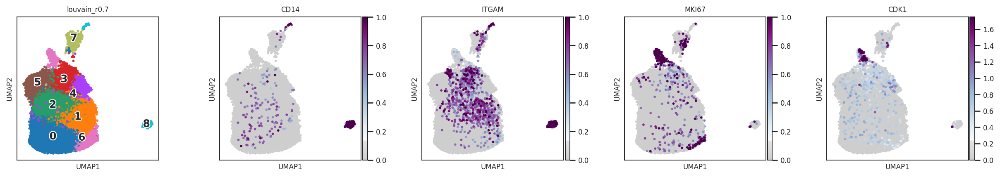

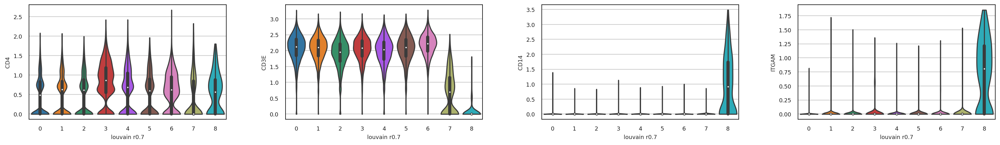

In [36]:
colors2 = plt.cm.BuPu(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)
def my_vmin(values): return np.mean(values)
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=8, vector_friendly=False, format='png', figsize=(3,3))
sc.pl.umap(mnn_corrected, color=['louvain_r0.7','CD14','ITGAM', 'MKI67', 'CDK1'], color_map=mymap, ncols=5,   vmax=[1,1,1,1, 1.75, 1.0, 1.4, 2.5], s=30, add_outline=False, legend_loc='on data', legend_fontsize=12, legend_fontoutline=2, wspace=0.3)
sc.set_figure_params(figsize=(5,3),fontsize=8, vector_friendly=False, format='png')
sc.pl.violin(mnn_corrected, keys=['CD4', 'CD3E', 'CD14','ITGAM'], groupby='louvain_r0.7', stripplot=False, inner='box')

After this filtering we recalculated the neighborhood graph on the latent space in order to cluster and annotate the resulting cleaned data.

In [37]:
clusters_to_include = [g for g in mnn_corrected.obs['louvain_r0.7'].cat.categories if g in ['0', '1', '2', '3', '4', '5', '6']]
mnn_corrected_ent = mnn_corrected[np.isin(mnn_corrected.obs['louvain_r0.7'], clusters_to_include),:].copy()
mnn_corrected_ent = mnn_corrected_ent[:,mnn_corrected_ent.var[((((mnn_corrected_ent.layers['counts'].T.todense()) > 0).sum(1)) > 3).squeeze().tolist()[0]].index]
sc.pp.highly_variable_genes(mnn_corrected_ent, flavor='cell_ranger', n_top_genes=4000, layer='norm_log2_counts')
calculate_visulizations(mnn_corrected_ent, components_n=20, th=150)

In [38]:
mnn_corrected_ent.write('CD4_no_bc_v_clean.h5ad')

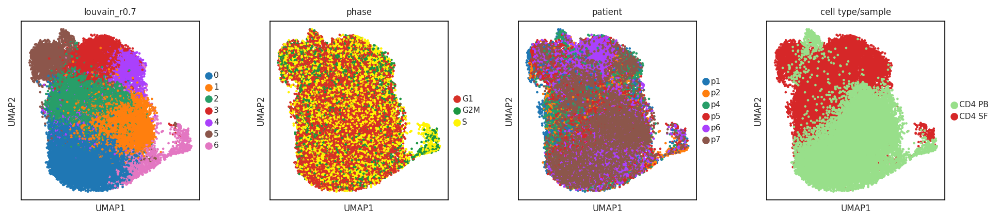

In [39]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=8, vector_friendly=False, format='png', figsize=(3,3))
sc.pl.umap(mnn_corrected_ent, color=['louvain_r0.7', 'phase', 'patient', "cell type/sample"], use_raw=False, s=20)

In [40]:
mnn_corrected_ent.uns['cell type/sample_colors'] = ['#98df8a', '#d62728']
mnn_corrected_ent.uns['sample_type_colors'] = ['#98df8a', '#d62728']

#### Cluster annotation
Removed the unwanted cells we looked for marker genes for each cluster in order to define the cell type

In [41]:
sc.tl.rank_genes_groups(mnn_corrected_ent, groupby='louvain_r0.7', key_added='rank_genes_louvain_r0.7')
pd.DataFrame(mnn_corrected_ent.uns['rank_genes_louvain_r0.7']['names']).head(20)

,0,1,2,3,4,5,6
0,RPS8,LTB,IL7R,S100A4,SRGN,CST7,ACTG1
1,RPL32,EEF1A1,CCL5,LGALS1,ALOX5AP,GZMK,ACTB
2,RPS3A,RPS12,GZMA,SH3BGRL3,CD74,GZMA,PFN1
3,RPL30,RPL34,ANXA1,CLIC1,YWHAB,CCL5,RAC2
4,RPS13,RPL18A,S100A11,S100A6,NR3C1,CD74,CNN2
5,RPL39,RPL10,LYAR,S100A11,HLA-DRB1,GZMH,CORO1A
6,SELL,RPL13,S100A10,S100A10,FAM129A,APOBEC3G,TMSB10
7,TCF7,RPL32,CXCR4,MYL6,HLA-DPA1,NKG7,SLC25A5
8,RPL11,RPL19,KLF6,CD99,TSC22D3,HLA-DPB1,H3F3A
9,RPS12,RPL11,GZMK,GAPDH,TIGIT,HLA-DRB1,ARHGDIB


<p style='text-align: justify;'> By looking marker genes we observed a ribosomal genes enrichment in Periferal Blood clusters and a "Toxic signature" markers enrichment in cluster 5.
In order to better characterize these populations we evaluated the distribution of canonical markers already used in another JIA work.</p>
    
##### "Julé, Amélie M., et al. "Th1 polarization defines the synovial fluid T cell compartment in oligoarticular juvenile idiopathic arthritis." JCI insight 6.18 (2021)."

In [42]:
Markers = {'Treg':['FOXP3', 'IL2RA', 'IKZF2', 'CTLA4', 'TNFRSF18'],'Th1':['CXCR3', 'TBX21', 'STAT1', 'IL12RB2', 'STAT2', 'IFNG'],'IFN stimulated':['IRF1', 'IRF3', 'IRF7', 'ISG15'],'CTL':['GZMA','PRF1'],'Th17':['KLRB1', 'CCR6', 'RORC'], 'Activation Naive/Memory':['HLA-DRB1', 'PDCD1','TIGIT', 'LAG3', 'CCR7', 'SELL', 'TCF7']}
Markers = {'Th1':['CXCR3', 'TBX21', 'STAT1', 'IL12RB2', 'STAT2', 'IFNG'],'IFN stimulated':['IRF1', 'IRF3', 'IRF7', 'ISG15'],'CTL':['GZMA','PRF1'],'Th17':['KLRB1', 'CCR6', 'RORC', 'CTSH', 'BATF'], 'Activation Naive/Memory':['HLA-DRB1', 'PDCD1','TIGIT', 'CTLA4', 'LAG3', 'CCR7', 'SELL', 'TCF7'], '':['CD69', 'ITGAE']}

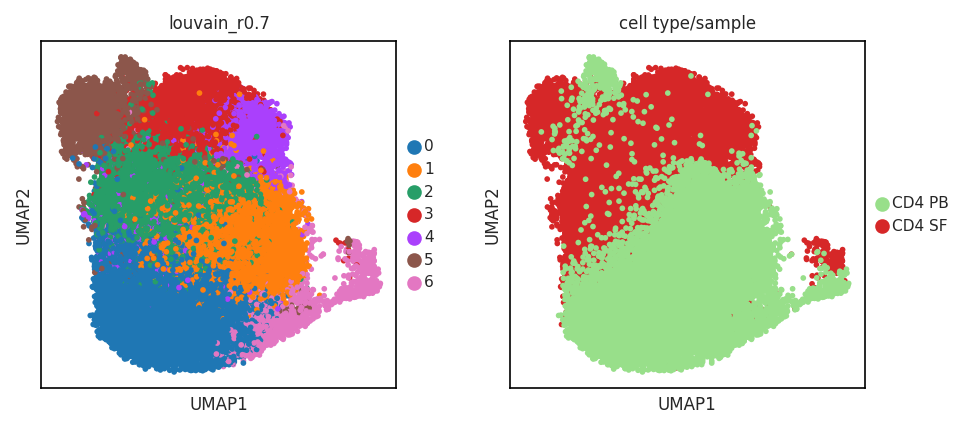

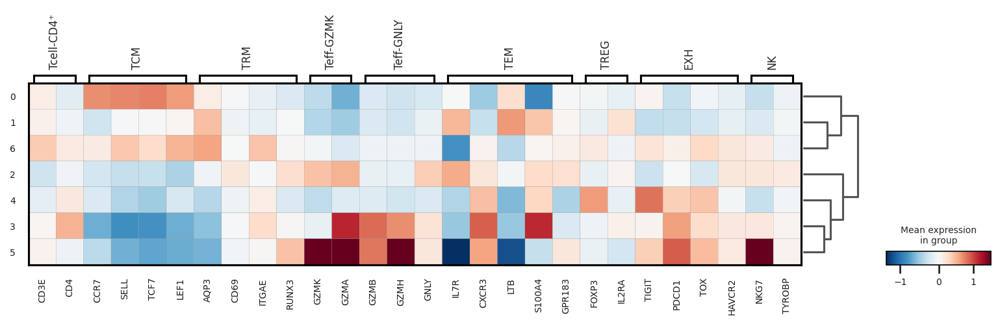

In [43]:
colors2 = plt.cm.BuPu(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)
mnn_corrected_ent.uns['cell type/sample_colors'] = ['#98df8a', '#d62728']
sc.pl.umap(mnn_corrected_ent, color=['louvain_r0.7',"cell type/sample"], color_map=mymap, s=30, wspace=0.2, size=(2,2))
mnn_corrected_ent.layers['scaled'] = sc.pp.scale(mnn_corrected_ent.layers["norm_log2_counts"], copy=True)
rcParams['patch.edgecolor']= 'black'
sc.tl.dendrogram(mnn_corrected_ent, 'louvain_r0.7')
sc.pl.matrixplot(mnn_corrected_ent, var_names={'Tcell-CD4'+'\u207a':['CD3E', 'CD4'], 'TCM':['CCR7', 'SELL', 'TCF7', 'LEF1'], 'TRM':['AQP3', 'CD69', 'ITGAE','RUNX3'],'Teff-GZMK':['GZMK', 'GZMA'], 'Teff-GNLY':['GZMB', 'GZMH', 'GNLY'], 'TEM':['IL7R','CXCR3','LTB', 'S100A4', 'GPR183'], 'TREG':['FOXP3', 'IL2RA'],'EXH':['TIGIT', 'PDCD1','TOX','HAVCR2'], 'NK':['NKG7', 'TYROBP']}, groupby='louvain_r0.7', layer='scaled', cmap='RdBu_r', dendrogram=True, vcenter=0, vmax=1.5)#vmax=2,standard_scale='var',
rcParams['patch.edgecolor']= 'white'

These representation confirms a heavy expression of cytotoxic markers in cluster 5.

### Ribosome distribution
Next we looked for riosomal genes distribution to confirm observations made on periferal blood clusters.

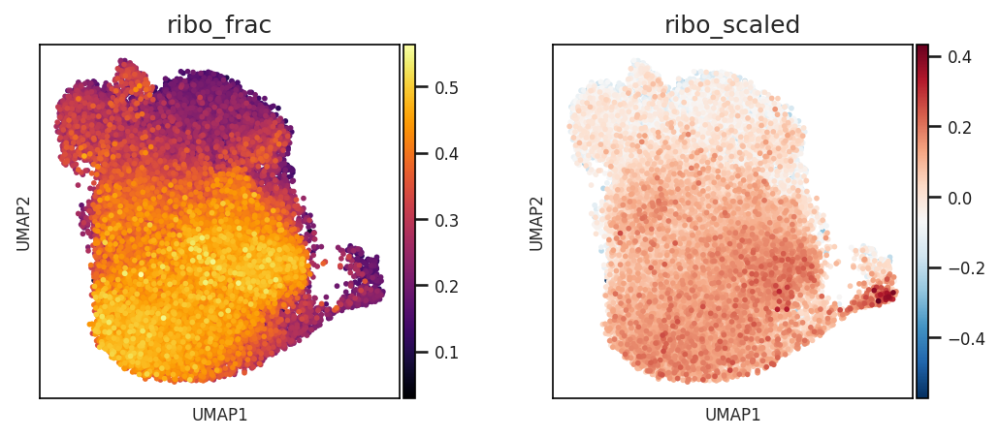

In [44]:
ribosomal_genes = mnn_corrected_ent.var_names.str.startswith('RP')
mnn_corrected_ent.obs['ribo_frac'] = (np.sum(mnn_corrected_ent[:, ribosomal_genes].layers['counts'], axis=1).squeeze()/np.sum(mnn_corrected_ent.layers['counts'], axis=1).squeeze()).tolist()[0]
mnn_corrected_ent.obs['ribo_scaled'] = mnn_corrected_ent[:,ribosomal_genes].layers['scaled'].mean(1)
fig = plt.figure(figsize=(8,3.2))
gs = fig.add_gridspec(1,2, hspace=0.2, wspace=0.3)
for i,n in zip(['ribo_frac', 'ribo_scaled'], range(2)):
    cmaps = ['inferno', 'RdBu_r']
    ax1 = fig.add_subplot(gs[0, n])
    ax1_dict = sc.pl.umap(mnn_corrected_ent, color=i, ax=ax1, color_map=cmaps[n], s=30,  show=False)
    ax1.set_title(i, size=12, loc='center')       

### Cell type assessment
To better characterize the cell populations in the dataset we looked for gene sets used by the author of this dataset.
    
##### "Maschmeyer, Patrick, et al. "Antigen‐driven PD‐1+ TOX+ BHLHE40+ and PD‐1+ TOX+ EOMES+ T lymphocytes regulate juvenile idiopathic arthritis in situ." European Journal of Immunology 51.4 (2021): 915-929."

In [45]:
REACTOME_TCR_SIGNALING = {'REACTOME_TCR_SIGNALING':['PSMB1', 'CD4', 'PSMC4', 'WAS', 'PSMA4', 'LCP2', 'PIK3CB', 'CUL1', 'TAB2', 'PRKCQ', 'PSME4', 'UBE2D1', 'FBXW11', 'PAG1', 'PAK3', 'PTPRC', 'PSMC5', 'PSME1', 'PSMD5', 'PSMD8', 'CDC34', 'GRAP2', 'PSMC6', 'PSMA3', 'PSMC1', 'PSMB5', 'PSMA6', 'NFKBIA', 'PSME2', 'PSMA7', 'PSMD10', 'PSMD7', 'CSK', 'RIPK2', 'IKBKB', 'PIK3R2', 'PSMA2', 'PSMD3', 'PSMD11', 'NFKB1', 'PSMD9', 'ITK', 'SKP1', 'ZAP70', 'PSMD14', 'PIK3CA', 'PLCG1', 'VASP', 'PSMF1', 'PSMB2', 'SEM1', 'PSMA1', 'PSME3', 'UBE2D2', 'PTPN22', 'CD101', 'MAP3K7', 'PSMB7', 'PDPK1', 'PSMB6', 'BCL10', 'PSMA5', 'RPS27A', 'PIK3R1', 'PTPRJ', 'PAK1', 'UBC', 'ENAH', 'PSMA8', 'NCK1', 'PSMD4', 'PSMB4', 'CD3G', 'PSMC2', 'TRAT1', 'PSMD6', 'PSMC3', 'BTRC', 'CD3D', 'HLA-DPA1', 'INPP5D', 'UBB', 'PTEN', 'MALT1', 'RELA', 'PSMD1', 'TRAF6', 'PSMD2', 'UBE2N', 'PAK2', 'LCK', 'PSMD13', 'HLA-DRB3', 'HLA-DRB1', 'EVL', 'HLA-DQB2', 'HLA-DQA1', 'PSMD12', 'PLCG2', 'CARD11', 'HLA-DRB5', 'CD247', 'CD3E', 'PSMB8', 'HLA-DRA', 'PSMB10', 'HLA-DPA1', 'PSMB8', 'HLA-DQA2', 'HLA-DQA1', 'HLA-DRA', 'TRAV8-4', 'TRAV19', 'TRAV29DV5', 'CHUK', 'LAT', 'HLA-DPB1', 'UBA52', 'PSMB11', 'HLA-DQA2', 'HLA-DPB1', 'HLA-DPA1', 'HLA-DQB2', 'HLA-DQA2', 'HLA-DQB1', 'HLA-DQB2', 'PSMB8', 'HLA-DRA', 'HLA-DPB1', 'HLA-DRB4', 'HLA-DRA', 'HLA-DRB1', 'HLA-DPA1', 'HLA-DQB2', 'HLA-DQB2', 'HLA-DRA', 'HLA-DQB2', 'HLA-DPA1', 'PSMB8', 'PSMB8', 'HLA-DQB2', 'HLA-DRA', 'HLA-DPB1', 'HLA-DRB4', 'HLA-DQB1', 'HLA-DPA1', 'HLA-DQA2', 'PSMB8', 'HLA-DRB3', 'HLA-DQA2', 'HLA-DQA1', 'HLA-DQB2', 'HLA-DQA2', 'HLA-DQB1', 'HLA-DRA', 'PSMB8', 'HLA-DPA1', 'HLA-DPA1', 'PSMB8', 'HLA-DPB1', 'HLA-DQA2', 'HLA-DPB1', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'UBE2V1', 'HLA-DQA2', 'PTPRC', 'IKBKG', 'TRBV12-3', 'PSMB3', 'HLA-DRA', 'PSMB3', 'TRBV7-9', 'PSMC4', 'INPP5D', 'TRBV12-3', 'PSME2', 'PSME1'],
                          'NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN':['ACTN4', 'ADAM19', 'AHR', 'AKIRIN2', 'ALCAM', 'ALOX5AP', 'ANKRD32', 'ANTXR2', 'ANXA1', 'ANXA2', 'ANXA2P1', 'ANXA4', 'AQP3', 'ARHGAP18', 'ASB2', 'ATP2B4', 'ATXN1', 'B3GNT9', 'BTG3', 'C11ORF75', 'C13ORF31', 'C17ORF91', 'C6ORF1', 'CALHM2', 'CAPG', 'CASK', 'CAST', 'CBLL1', 'CCDC107', 'CCL5', 'CCR2', 'CCR6', 'CD226', 'CD28', 'CD58', 'CD63', 'CD74', 'CD84', 'CDC42EP3', 'CDK2AP2', 'CHST7', 'CLDND1', 'CLIC1', 'CLU', 'CNPPD1', 'COTL1', 'CPPED1', 'CREB3L2', 'CRELD2', 'CRIP1', 'CRYBG3', 'CTSA', 'CTSC', 'CXCR3', 'DNAI2', 'DUSP16', 'DUSP5', 'EFHD2', 'EIF2C4', 'EIF3A', 'EIF4EBP2', 'ELOVL5', 'EPS15', 'EVI2B', 'FAM129A', 'FAM164A', 'FAM38A', 'FAR2', 'FAS', 'FBXL8', 'FRMD4B', 'GBP3', 'GCLM', 'GDPD5', 'GLIPR1', 'GOLGA7', 'GSTK1', 'GZMA', 'GZMK', 'HLA-DPA1', 'HMGN4', 'HN1', 'HNRPLL', 'HOPX', 'IFI16', 'IFI27', 'IFNG', 'IL10RA', 'IL15RA', 'IQGAP1', 'IQGAP2', 'ITGB1', 'KIAA0895L', 'KIF1B', 'KIF21A', 'KLRB1', 'LDHA', 'LGALS1', 'LGALS3', 'LIMS1', 'LIMS3', 'LOC100131176', 'LOC100288693', 'LOC100506190', 'LOC338620', 'LOC730184', 'MAP3K5', 'MDFIC', 'MFHAS1', 'MIAT', 'MIB1', 'MICAL2', 'MIS18BP1', 'MLF1', 'MLLT4', 'MTSS1', 'MYBL1', 'MYL6', 'MYO1F', 'NCAPH', 'NCF4', 'NETO2', 'NINJ2', 'NMU', 'NOD2', 'NPC1', 'NPDC1', 'OBFC2A', 'OBFC2B', 'OGDH', 'OGFRL1', 'OSBPL3', 'PAM', 'PDIA6', 'PEA15', 'PFKL', 'PHACTR2', 'PHTF2', 'PLXNC1', 'PPIF', 'PPP1CA', 'PREX1', 'PRR5L', 'PTTG1', 'PVRL3', 'RAB27A', 'REEP3', 'REEP5', 'RFTN1', 'RGS3', 'RHOU', 'RNF126', 'RNF149', 'RORA', 'S100A11', 'S100A4', 'SAP30', 'SEC11C', 'SH2D1A', 'SH3BGRL3', 'SH3BP5', 'SLC2A3', 'SLC35D2', 'SLC9A3R1', 'SMAP1', 'SPAG1', 'SPOPL', 'SRGN', 'SSR3', 'ST8SIA1', 'STOM', 'STX11', 'TBCB', 'TBX21', 'TIGIT', 'TLR3', 'TMEM116', 'TMEM156', 'TMEM200A', 'TMEM64', 'TMX4', 'TNF', 'TNFRSF4', 'TOR3A', 'TP53INP1', 'TPM4', 'TRAC', 'TRADD', 'TTC39C', 'TTYH2', 'TXN', 'TYMP', 'UBL3', 'USP46', 'UST', 'VCL', 'YWHAH', 'ZBTB38', 'ZC3HAV1L', 'ZNF532'],
                          'REACTOME_CELL_CYCLE':['MAD1L1', 'CDC27', 'POLR2J', 'PRKAR2B', 'DBF4', 'PAFAH1B1', 'E2F2', 'PSMB1', 'CDK11A', 'NCAPD2', 'BRCA1', 'PSMC4', 'POLA2', 'MNAT1', 'MRE11', 'SPAST', 'PHF20', 'NCAPH2', 'VRK2', 'NUP160', 'CENPQ', 'RFC1', 'TUBG2', 'SPDL1', 'PSMA4', 'OFD1', 'POLR2B', 'TPR', 'RSF1', 'RFC2', 'RAD51', 'ANAPC4', 'SDCCAG8', 'SYNE2', 'SPO11', 'CUL1', 'MSH4', 'PPP1R12A', 'NDC1', 'WAPL', 'POLD1', 'MCM10', 'PPP2R5A', 'STAG3', 'TP53BP1', 'KIF2A', 'PSME4', 'SIRT2', 'PPP2R5B', 'NUP133', 'CSNK2A2', 'PRKACA', 'UBE2D1', 'SMC1A', 'HMMR', 'FBXW11', 'NDE1', 'MCM2', 'CLASP1', 'NUP37', 'GTSE1', 'TUBA3D', 'MCM6', 'MLH1', 'PPP1R12B', 'DYNC1I2', 'POLD3', 'FKBP6', 'SMC1B', 'PPP2R5C', 'PCM1', 'CDC14A', 'HSP90AA1', 'RBL1', 'NDC80', 'GSK3B', 'XPO1', 'TNPO1', 'PDS5B', 'CHMP2B', 'ATRX', 'SEH1L', 'ORC1', 'ZW10', 'PSMC5', 'UIMC1', 'AURKA', 'TPX2', 'DYNLL1', 'ANAPC5', 'BIRC5', 'PCBP4', 'NUDC', 'ORC6', 'PSME1', 'HAUS4', 'TINF2', 'CLSPN', 'NUP50', 'CDC45', 'CDC6', 'CDC23', 'AAAS', 'PSMD5', 'NUP188', 'HSP90AB1', 'JAK2', 'ABL1', 'CDC7', 'PSMD8', 'POLR2E', 'MAPK1', 'POLR2F', 'CENPM', 'DMC1', 'SUN2', 'MCM5', 'RBX1', 'EP300', 'RANGAP1', 'POLE2', 'PSMC6', 'PSMA3', 'VRK1', 'PSMC1', 'PSMB5', 'PSMA6', 'PSME2', 'REC8', 'GINS1', 'NINL', 'MYBL2', 'RAE1', 'TUBB1', 'PSMA7', 'DIDO1', 'PTK6', 'CDC25B', 'CSNK2A1', 'MAPRE1', 'E2F1', 'CHMP4B', 'LPIN2', 'CEP76', 'CEP192', 'RBBP8', 'PSMD10', 'POLA1', 'STAG2', 'RBBP7', 'EMD', 'CENPI', 'MAPK3', 'NUP93', 'CENPT', 'ACD', 'POLR2C', 'PSMD7', 'UBE2I', 'RBL2', 'CCP110', 'CEP152', 'OIP5', 'NBN', 'RAB2A', 'PPP2CB', 'MCM4', 'TUBB4A', 'CCNE1', 'AKT2', 'PIAS4', 'POLR2I', 'FZR1', 'BABAM1', 'LIG1', 'PPP2R1A', 'CDK6', 'H2AZ2', 'RPA3', 'CEP41', 'PSMA2', 'POLD2', 'STN1', 'SMC3', 'UBE2S', 'PSMD3', 'RAD51C', 'KPNB1', 'NUP88', 'PSMD11', 'YWHAE', 'GAR1', 'NSD2', 'NCAPG', 'PPP6R3', 'CCND1', 'ANAPC15', 'CEP164', 'NUP98', 'PSMD9', 'FOXM1', 'CDKN1B', 'RFC5', 'NUP107', 'FBXO5', 'MCM3', 'RNF8', 'E2F3', 'GMNN', 'CCND3', 'PPP2R5D', 'CEP72', 'KIF20A', 'LMNB1', 'RAD1', 'RAD50', 'SKP1', 'NUP155', 'PPP2CA', 'SMC4', 'CEP70', 'TFDP2', 'GORASP1', 'CENPA', 'PSMD14', 'POLE4', 'CHMP3', 'GORASP2', 'ORC2', 'ORC4', 'SUMO1', 'ALMS1', 'HDAC1', 'AKT3', 'CDC20', 'BLZF1', 'NEK2', 'NSL1', 'CENPF', 'RPA2', 'STAG1', 'CCND2', 'SET', 'CNTRL', 'NEK6', 'PPP6C', 'NEK9', 'MLH3', 'NUP43', 'CENPL', 'MASTL', 'TMPO', 'NCAPH', 'MND1', 'KIF18A', 'PDS5A', 'ZWINT', 'CDKN2C', 'CENPK', 'OPTN', 'CDK2', 'TUBA1B', 'HJURP', 'B9D2', 'H2BC11', 'CDKN1A', 'NUP153', 'NUP85', 'PSMF1', 'MCM8', 'MAX', 'CEP250', 'PSMB2', 'TUBGCP3', 'HSPA2', 'NUP214', 'PKMYT1', 'CHTF18', 'TUBA4A', 'AKAP9', 'SEM1', 'TUBGCP6', 'YWHAH', 'POT1', 'HERC2', 'ARPP19', 'PSMA1', 'CDKN2D', 'AJUBA', 'MIS18BP1', 'CDKN1C', 'SGO1', 'MAU2', 'CDC16', 'TUBGCP2', 'CHMP2A', 'CLIP1', 'DKC1', 'SYNE1', 'GINS2', 'HAUS8', 'TUBG1', 'PSME3', 'PSMC3IP', 'TOP2A', 'NUP210', 'RAN', 'RPA1', 'H3-3B', 'TERF2', 'VPS4A', 'PCNA', 'LPIN3', 'CCNA1', 'RFC3', 'E2F5', 'TEX15', 'CCNB1', 'CDK7', 'YWHAQ', 'LPIN1', 'CCNH', 'CABLES1', 'CDCA8', 'ORC3', 'CDK4', 'ESPL1', 'MDM2', 'DYNC1LI2', 'BORA', 'NUP42', 'HUS1', 'BRIP1', 'ODF2', 'SMC2', 'CDK5RAP2', 'PSMB7', 'DSCC1', 'MYC', 'DCTN3', 'TUBB2A', 'TUBB2B', 'MDC1', 'NUMA1', 'PPP2R1B', 'KIF23', 'KNL1', 'HAUS2', 'TUBGCP4', 'RAB1A', 'CENPO', 'ACTR1A', 'DNA2', 'BARD1', 'NUP54', 'USO1', 'CENPE', 'PHLDA1', 'NEDD1', 'SYCP3', 'NUP58', 'BRCA2', 'RB1', 'PIF1', 'KIF2B', 'ESCO1', 'WRAP53', 'TP53', 'CSNK1D', 'ANAPC11', 'CEP131', 'AKT1', 'PSMB6', 'PLK4', 'ITGB3BP', 'KIF2C', 'PSMA5', 'NME7', 'COP1', 'NUF2', 'ENSA', 'LBR', 'EML4', 'RPS27A', 'POLR2D', 'DYNC1LI1', 'SHQ1', 'CENPC', 'CCNA2', 'SKP2', 'NHP2', 'H2BC1', 'PRIM2', 'CDCA5', 'NCAPG2', 'HDAC8', 'MCPH1', 'CETN2', 'CHMP7', 'GINS4', 'TERF1', 'POLR2K', 'HAUS6', 'CDKN2B', 'CDKN2A', 'CEP78', 'POLE3', 'ATM', 'INCENP', 'CHEK1', 'DSN1', 'TEX12', 'UBC', 'RAD9B', 'NEK7', 'NCAPD3', 'CENPU', 'CENPJ', 'MZT2B', 'TUBA3E', 'HAUS1', 'SPC25', 'RAD17', 'CENPH', 'ANAPC1', 'SMARCA5', 'RANBP2', 'AHCTF1', 'PPP2R5E', 'CC2D1B', 'PRKCA', 'BUB3', 'PSMA8', 'SKA1', 'FBXL18', 'NUP205', 'BUB1B', 'SEC13', 'CCNB2', 'DYRK1A', 'BABAM2', 'H2BC5', 'CDC25C', 'H4C8', 'DYNC1I1', 'MIS18A', 'PSMD4', 'PSMB4', 'PCNT', 'TAOK1', 'PMF1', 'LMNA', 'PSMC2', 'ZNF385A', 'SYCE2', 'SPC24', 'LEMD2', 'RBBP4', 'NUP35', 'H3-3A', 'ABRAXAS1', 'SGO2', 'CLASP2', 'PSMD6', 'TOPBP1', 'POLR2H', 'RFC4', 'RNF168', 'H2AZ1', 'CDC25A', 'ATRIP', 'MAD2L1', 'ANAPC10', 'NIPBL', 'PRDM9', 'TERT', 'PTTG1', 'CHMP4C', 'RAD21', 'ORC5', 'SUN1', 'YWHAZ', 'WRN', 'PSMC3', 'CEP57', 'BTRC', 'ANAPC16', 'CENPN', 'WEE1', 'PRKCB', 'MCM7', 'NDEL1', 'TERF2IP', 'PLK1', 'YWHAB', 'GOLGA2', 'PPP2R3B', 'RAB8A', 'CDT1', 'TUBA1A', 'TUBA1C', 'MIS12', 'TK1', 'POLR2G', 'H3-4', 'FEN1', 'CHTF8', 'E2F6', 'UBE2V2', 'BUB1', 'CENPX', 'YWHAG', 'UBE2E1', 'CDK1', 'UBB', 'ESCO2', 'SYCE1', 'RHNO1', 'RRM2', 'RAD9A', 'PHF8', 'KAT5', 'CKS1B', 'TUBB8B', 'MZT2A', 'PSMD1', 'LEMD3', 'EXO1', 'ZWILCH', 'CEP135', 'RAB1B', 'ATR', 'UBE2C', 'PSMD2', 'DCTN2', 'CKAP5', 'CENPS', 'CCNE2', 'BANF1', 'PPP2R2D', 'POLD4', 'RMI2', 'RUVBL1', 'SFN', 'CTDNEP1', 'TUBB6', 'SSNA1', 'CHMP6', 'ANAPC2', 'CDC26', 'TYMS', 'ANKLE2', 'POLE', 'TOP3A', 'POLR2L', 'UBE2N', 'RPS27', 'TUBAL3', 'RMI1', 'CTC1', 'AURKB', 'RCC2', 'RCC1', 'H2AC6', 'H2BC4', 'NPM1', 'POLR2A', 'GINS3', 'NOP10', 'IST1', 'SKA2', 'CEP63', 'RUVBL2', 'TUBB', 'FBXL7', 'H3C13', 'CHEK2', 'TUBA8', 'LIN9', 'KMT5A', 'H2AC20', 'KNTC1', 'H2BC21', 'H2BC13', 'BRCC3', 'PSMD13', 'PPP1CC', 'ERCC6L', 'TUBB4B', 'CENPP', 'H2AX', 'LIN54', 'SYCP2', 'TUBB', 'POM121', 'ANAPC7', 'H2AC7', 'H2BU1', 'H4C3', 'DYNC1H1', 'SRC', 'H3C12', 'PSMD12', 'H4C11', 'BLM', 'H3C4', 'H4-16', 'H2BC12', 'TUBA3C', 'PRIM1', 'SFI1', 'TFDP1', 'MDM4', 'CEP290', 'SYCP1', 'CENPW', 'H3C14', '', 'H3C15', 'RPA4', 'DAXX', 'PSMB8', 'FKBPL', 'MSH5', 'CSNK2B', 'DCTN1', 'MZT1', 'PSMB10', 'E2F4', 'CNEP1R1', 'LCMT1', 'LIN52', 'DAXX', 'DAXX', 'PSMB8', 'CSNK2B', 'MDC1', 'ANKRD28', 'NUP62', 'CEP43', 'HAUS7', 'PPP1CB', 'CSNK1E', 'HAUS3', 'PPME1', 'SYCE3', 'PPP2R2A', 'UBA52', 'PSMB11', 'FKBPL', 'TUBB', 'FKBPL', 'CSNK2B', 'MDC1', 'CSNK2B', 'MDC1', 'PSMB8', 'DAXX', 'MSH5', 'TUBB', 'MDC1', 'DHFR', 'CSNK2B', 'TUBB', 'PSMB8', 'MSH5', 'PSMB8', 'CSNK2B', 'FKBPL', 'MSH5', 'MDC1', 'DAXX', 'PSMB8', 'TUBB', 'TUBB', 'CSNK2B', 'H2BC15', 'MDC1', 'H2BC12L', 'TUBB', 'MSH5', 'PSMB8', 'PSMB8', 'MDC1', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'PSMB9', 'TUBA4B', 'PSMB9', 'H2AJ', 'CDK11B', 'HAUS5', 'LYN', 'CHMP4A', 'TEN1', 'RTEL1', 'TUBB3', 'TUBB8', 'SKA1', 'DYNLL2', 'LIN37', 'H4C15', 'H4C14', '', 'POM121C', 'H4C12', 'H2BC14', 'H2BC8', 'H3C8', 'H2AB1', 'H2BC6', 'YWHAE', 'H4C6', 'H2BC17', 'H3C6', 'H4C13', 'AKT3', 'H3C11', 'H2BC9', 'H3C1', 'TUBGCP5', 'PSMB3', 'NDE1', 'SDCCAG8', 'H4C9', 'H2AC14', 'H2BC3', 'RAD17', 'H4C5', 'H2AC8', 'H4C4', 'H2BC7', 'CDK7', 'H3C7', 'PSMB3', 'SPC25', 'H2AC4', 'H2BC10', 'H4C1', 'H4C2', 'H3C10', 'PSMC4', 'RCC2', 'E2F2', 'SIRT2', 'PRKAR2B', 'TOP3A', 'PSME2', 'RUVBL1', 'TINF2', 'PSME1', 'REC8', 'MCPH1', 'CHMP4A', 'H3-4', 'H2BU1', 'H3C2', 'H3C3', 'CTDNEP1', 'PRKACA', 'H2AC18', 'H2AC19'],
                          'TRM_CELLS_UP':['ITGA1','ITGAE','IL2','CXCR6','KCNK5', 'RGS1', 'CRTAM', 'DUSP6', 'PDCD1']}

for l in REACTOME_TCR_SIGNALING.keys():
    sc.tl.score_genes(mnn_corrected_ent, REACTOME_TCR_SIGNALING.get(l), ctrl_size=len(REACTOME_TCR_SIGNALING.get(l)), score_name=str(l)+'_score', use_raw=True)

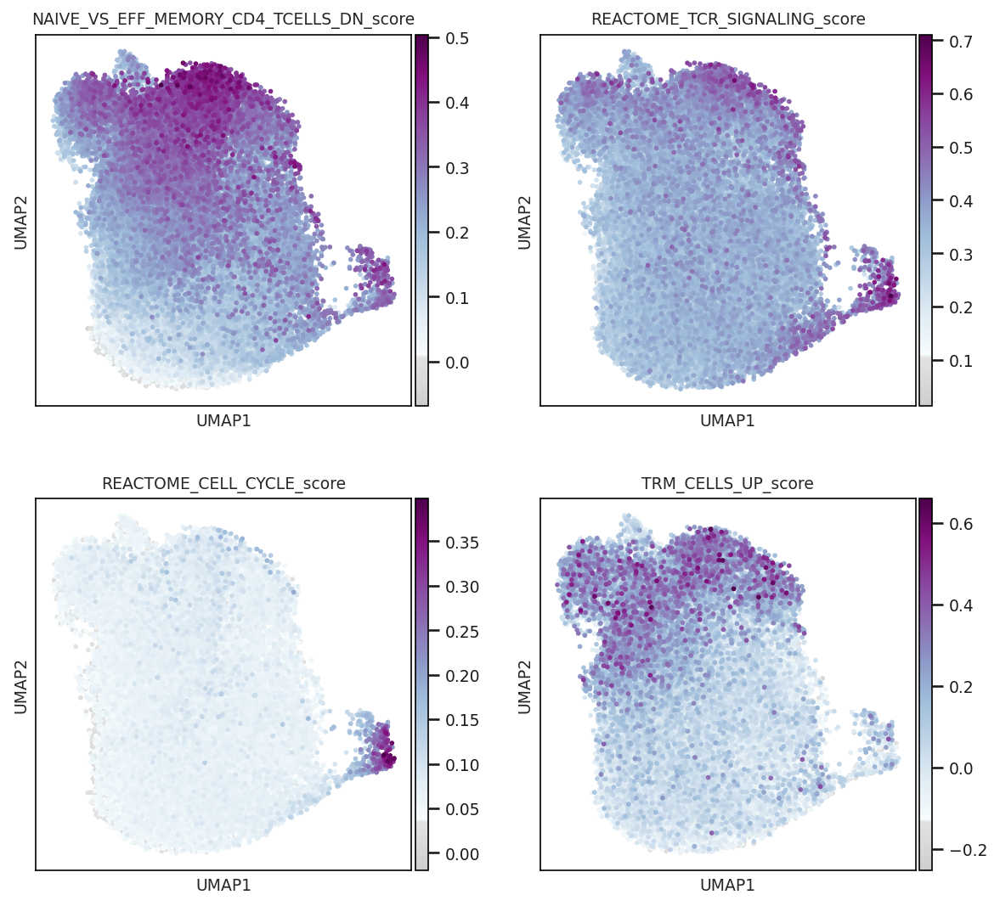

In [46]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=9, vector_friendly=False, format='png',  figsize=(3.7,4))
sc.pl.umap(mnn_corrected_ent, color=['NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score', 'REACTOME_TCR_SIGNALING_score', 'REACTOME_CELL_CYCLE_score', 'TRM_CELLS_UP_score'], color_map=mymap, ncols=2, s=30)

These results show presence of CD4 cells with an effector signature in the top of the figure, along with T resident memory cells. 

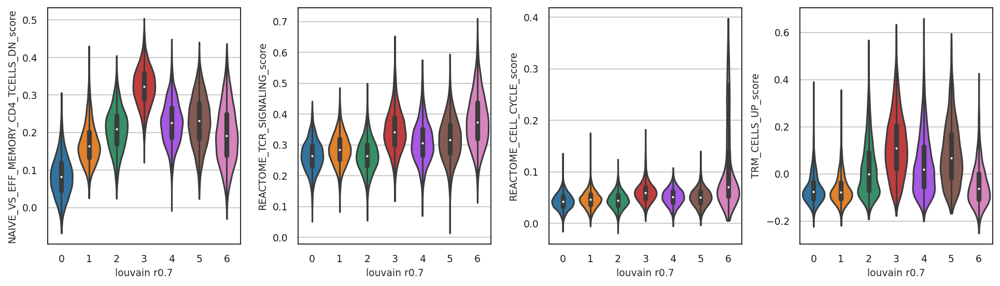

In [47]:
sc.pl.violin(mnn_corrected_ent, keys=['NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score', 'REACTOME_TCR_SIGNALING_score', 'REACTOME_CELL_CYCLE_score', 'TRM_CELLS_UP_score'], groupby='louvain_r0.7',stripplot=False, inner='box')

The violinplot confirms the observations above.

Basing on these observations we annotate cell clusters and evaluate their distribution among tissues.

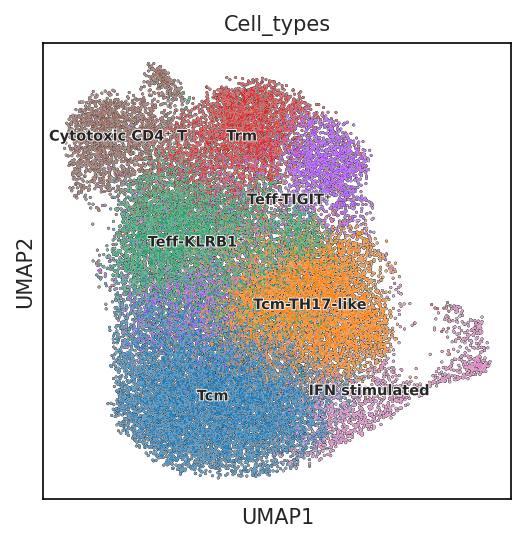

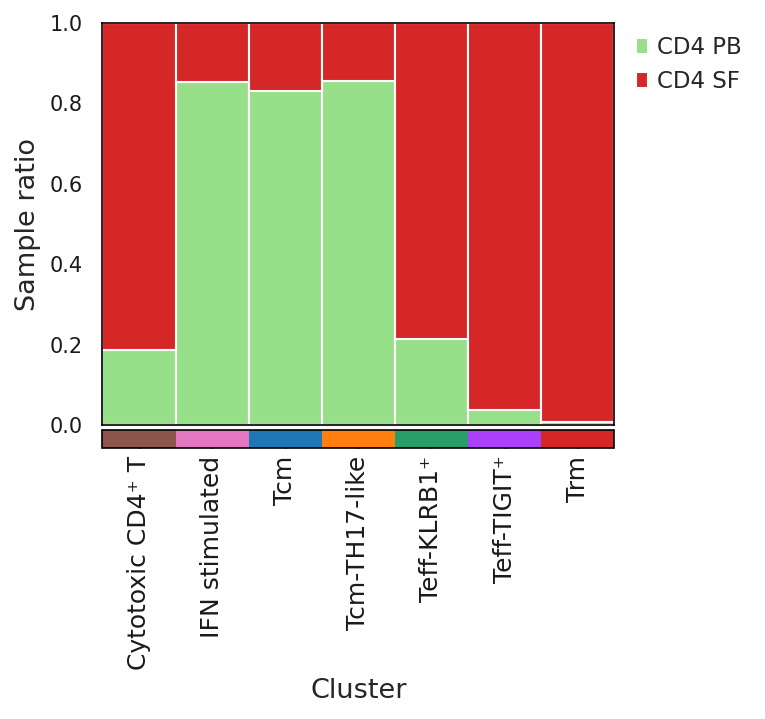

In [48]:
lines_vec = []
Tcm = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['0']]
Th17_like = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['1']]
Klrb = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['2']]
Trm = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['3']]
Teff_TIGIT = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['4']]
T_cytotox = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['5']]
IFN_stimulated = [g for g in mnn_corrected_ent.obs['louvain_r0.7'].cat.categories if g in ['6']]
for v,n in zip([Tcm,Th17_like, Klrb, Trm, Teff_TIGIT, T_cytotox, IFN_stimulated],
['Tcm', 'Tcm-TH17-like', 'Teff-KLRB1'+'\u207a','Trm','Teff-TIGIT'+'\u207a','Cytotoxic CD4'+'\u207a'+' T', 'IFN stimulated']):
    lines_vec.append(list(map(lambda x: [x,n], mnn_corrected_ent[np.isin(mnn_corrected_ent.obs['louvain_r0.7'], v),:].obs_names.to_list())))
LinesDF = pd.DataFrame(list(zip(*[item for sublist in lines_vec for item in sublist]))).T
mnn_corrected_ent.obs['Cell_types'] = LinesDF.drop_duplicates(0).set_index([0]).reindex(mnn_corrected_ent.obs_names.tolist())[1]
sc.set_figure_params(dpi=75, dpi_save=600, fontsize=10, vector_friendly=False, format='png')
sc.pl.umap(mnn_corrected_ent, color=['Cell_types'], add_outline=True, groups=['Tcm', 'Tcm-TH17-like', 'Teff-KLRB1'+'\u207a','Trm','Teff-TIGIT'+'\u207a','Cytotoxic CD4'+'\u207a'+' T', 'IFN stimulated'], legend_loc='on data', palette=['#8c564b', '#e377c2', '#1f77b4', '#ff7f0e', '#279e68', '#aa40fc', '#d62728'], legend_fontsize=7, legend_fontoutline=0.8, outline_width=(0.2,0.05),)#, save='_Cd3_lymphoid_populations')#save='Cd3_lymphoid_populations'
sc.set_figure_params(dpi=75, dpi_save=600, fontsize=13, vector_friendly=False, format='png')
sc.tl.dendrogram(mnn_corrected_ent, 'Cell_types')
distro_barplot(mnn_corrected_ent, 'Cell_types', "cell type/sample", xlabel='Cluster', ylabel='Sample ratio', save=False)

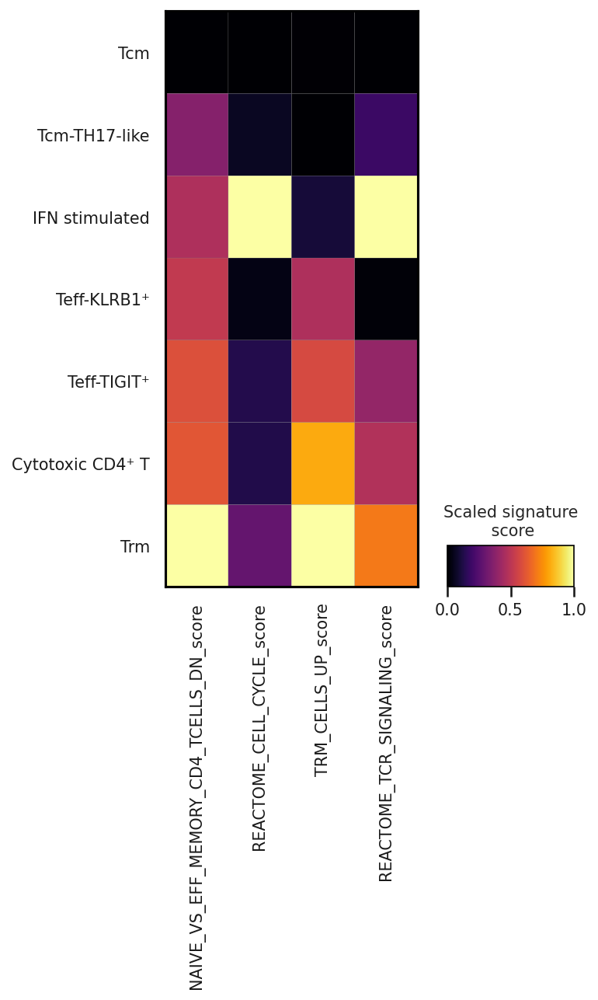

In [49]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=12)
rcParams['patch.edgecolor']= 'black'
sc.pl.matrixplot(mnn_corrected_ent, var_names=['NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score', 'REACTOME_CELL_CYCLE_score', 'TRM_CELLS_UP_score','REACTOME_TCR_SIGNALING_score',], return_fig=False, use_raw=False, dendrogram=False, groupby='Cell_types',  cmap='inferno', standard_scale='var', categories_order=['Tcm','Tcm-TH17-like', 'IFN stimulated', 'Teff-KLRB1'+'\u207a', 'Teff-TIGIT'+'\u207a', 'Cytotoxic CD4'+'\u207a'+' T','Trm'], swap_axes=False, colorbar_title='Scaled signature\n score', figsize=(4.5,6.5))#categories_order=['0','1','6','2','4','5','3']#, save='lymphoid_populations')#
rcParams['patch.edgecolor']= 'white'

Above we plotted the genesets scores for each cell line and, below, the canonical markers to confirm clusters nature.

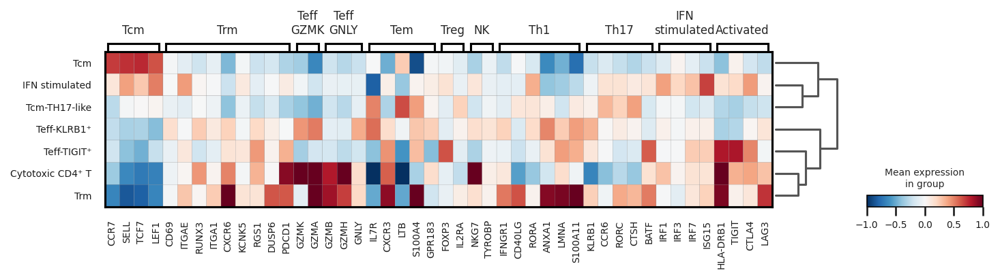

In [50]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=8, vector_friendly=False, format='png')
rcParams['patch.edgecolor']= 'black'
sc.pl.matrixplot(mnn_corrected_ent, var_names={'Tcm':['CCR7', 'SELL', 'TCF7', 'LEF1'], 'Trm':['CD69', 'ITGAE','RUNX3','ITGA1','CXCR6','KCNK5', 'RGS1','DUSP6', 'PDCD1'],'Teff\nGZMK':['GZMK', 'GZMA'], 'Teff\nGNLY':['GZMB', 'GZMH', 'GNLY'], 'Tem':['IL7R','CXCR3','LTB', 'S100A4', 'GPR183'], 'Treg':['FOXP3', 'IL2RA'], 'NK':['NKG7', 'TYROBP'], 'Th1':['IFNGR1','CD40LG', 'RORA', 'ANXA1', 'LMNA', 'S100A11'], 'Th17':['KLRB1', 'CCR6', 'RORC', 'CTSH', 'BATF'], 'IFN\nstimulated':['IRF1', 'IRF3', 'IRF7', 'ISG15'], 'Activated':['HLA-DRB1', 'TIGIT', 'CTLA4', 'LAG3']}, groupby='Cell_types', categories_order = ['Tcm', 'Tcm-TH17-like', 'IFN stimulated',  'Cytotoxic CD4'+'\u207a'+' T', 'Teff-KLRB1'+'\u207a', 'Trm',  'Teff-TIGIT'+'\u207a'], return_fig=False, use_raw=False, dendrogram=True, layer='scaled', vcenter=0, vmax=1, vmin=-1,  cmap='RdBu_r', swap_axes=False, figsize=(11,2), var_group_rotation=0)#, save='lymphoid_populations')#
rcParams['patch.edgecolor']= 'white'

### Th1 an Th17 distribution

Here we define Th1- and Th17- like cells looking for the expression of typical markers already used in previous works [Yost K.E. et al., 2019, McCluskey D. et al., 2022, Andreatta M. et al., 2021], and calculated their distribution density through the ```tl.embedding_density``` scanpy function.

In [51]:
gene_group_mean(mnn_corrected_ent, {'Th1':['IFNGR1','FASL','CD40LG', 'KLRB1', 'RORA', 'ANXA1', 'CDKN1A', 'LMNA', 'S100A11'], 'Th17':['KLRB1', 'CCR6', 'RORC', 'CTSH', 'BATF']})
def func(x):
    if x > 0.76:
        return 'Th1'
    else:
        return 'other'
mnn_corrected_ent.obs['Th1_cat'] = mnn_corrected_ent.obs['Th1'].apply(func)
def func(x):
    if x > 0.3:
        return 'Th17'
    else:
        return 'other'
mnn_corrected_ent.obs['Th17_cat'] = mnn_corrected_ent.obs['Th17'].apply(func)

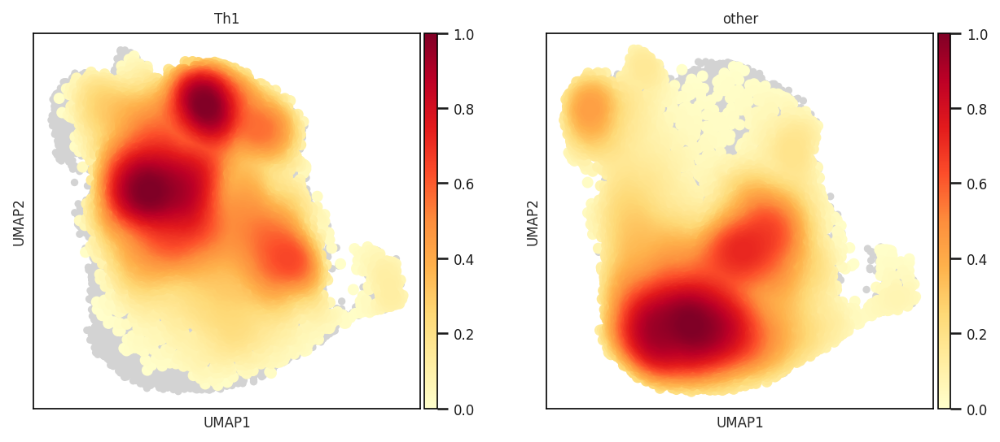

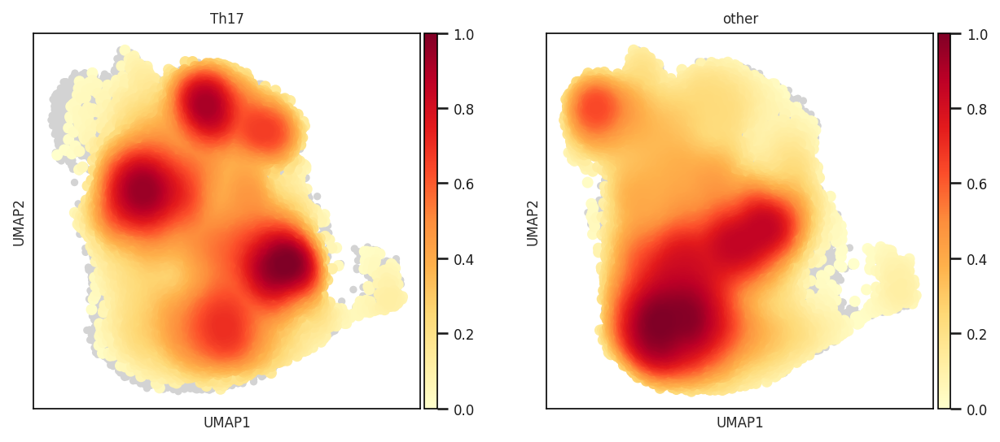

In [52]:
sc.tl.embedding_density(mnn_corrected_ent, basis='umap', groupby='Th1_cat')
sc.pl.embedding_density(mnn_corrected_ent, key='umap_density_Th1_cat')
sc.tl.embedding_density(mnn_corrected_ent, basis='umap', groupby='Th17_cat')
sc.pl.embedding_density(mnn_corrected_ent, key='umap_density_Th17_cat')

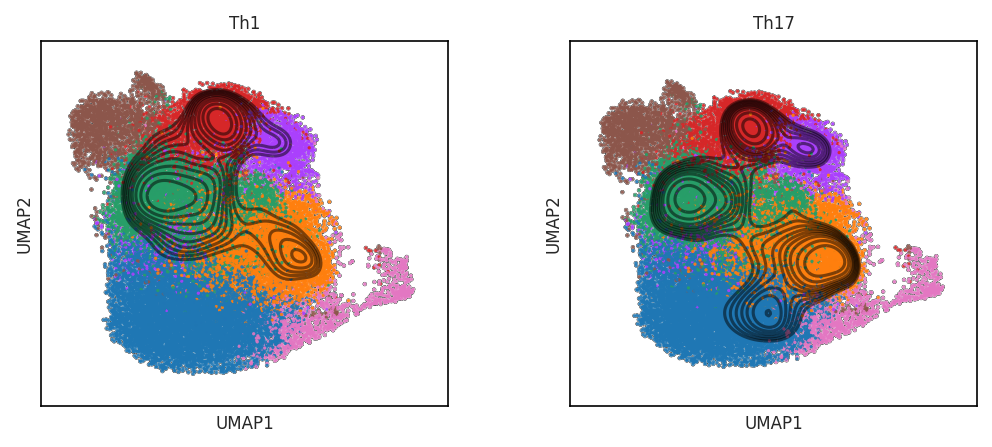

In [53]:
components = '1,2'
components = components.split(',')
components = np.array(components).astype(int) - 1
fig = plt.figure(figsize=(8,3.2))
gs = fig.add_gridspec(1,2, hspace=0.2, wspace=0.3)
for i,n in zip(['Th1_cat','Th17_cat'], range(2)):
    ax1 = fig.add_subplot(gs[0, n])    
    cat_mask = mnn_corrected_ent.obs[i] == i.split('_')[0]
    embed_x = mnn_corrected_ent.obsm[f'X_umap'][cat_mask, components[0]]
    embed_y = mnn_corrected_ent.obsm[f'X_umap'][cat_mask, components[1]]
    sc.pl.umap(mnn_corrected_ent, s=10, color = 'louvain_r0.7', ax=ax1, legend_loc = None, show=False, alpha = 0.9, title = i.split('_')[0], outline_width=(0.1,0.05), add_outline=True)
    sb.kdeplot(x=embed_x, y=embed_y, ax=ax1, color = '#00000080',thresh=0.4)
plt.show()

## 8. TCR analysis

Next, we performed the TCR analysis, categorizing cells on the basis of the detection of productive antigen receptor chains (```tl.chain_qc``` function) and selecting cells with a single pair of productive chains for further analysis. T cell clonotypes were defined at the amino acid level (```pp.ir_dist```, ```tl.define_clonotypes``` and ```tl.clonotype_network``` functions), considering both receptor chains. TCR diversity and TCR clonal size were estimated using ```tl.alpha_diversity``` and ```tl.clonal_expansion``` functions, respectively.

  0%|          | 0/13833 [00:00<?, ?it/s]

  0%|          | 0/39621 [00:00<?, ?it/s]

  0%|          | 0/39621 [00:00<?, ?it/s]

  0%|          | 0/13954 [00:00<?, ?it/s]

  0%|          | 0/13956 [00:00<?, ?it/s]

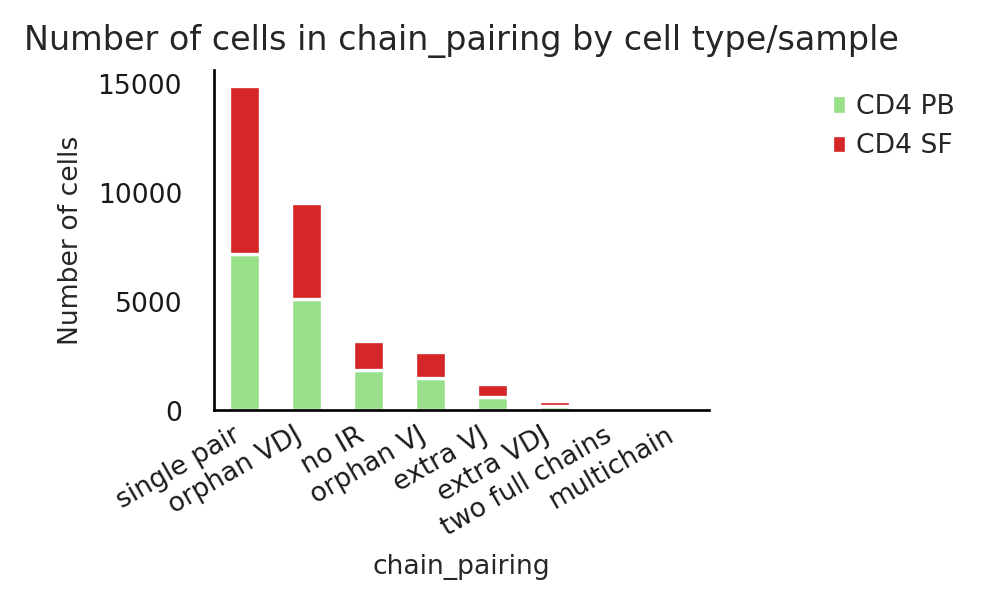

In [54]:
ir.tl.chain_qc(mnn_corrected_ent)
ax = ir.pl.group_abundance(mnn_corrected_ent, groupby='chain_pairing', target_col="cell type/sample")
mnn_corrected_ent = mnn_corrected_ent[~mnn_corrected_ent.obs["chain_pairing"].isin(["orphan VDJ", "orphan VJ", 'no IR']), :].copy()
ir.pp.ir_dist(mnn_corrected_ent)
ir.tl.define_clonotypes(mnn_corrected_ent, receptor_arms="all", dual_ir="primary_only")
ir.tl.clonotype_network(mnn_corrected_ent, min_cells=2)
ir.pp.ir_dist(mnn_corrected_ent,metric="alignment",sequence="aa",cutoff=15, n_jobs=150)
ir.tl.define_clonotype_clusters(mnn_corrected_ent, sequence="aa", metric="alignment", receptor_arms="all", dual_ir="any", n_jobs=50)
ir.tl.clonotype_network(mnn_corrected_ent, min_cells=3, sequence="aa", metric="alignment")
ir.tl.define_clonotype_clusters(mnn_corrected_ent,sequence="aa",metric="alignment",receptor_arms="all",dual_ir="any", same_v_gene=True, key_added="cc_aa_alignment_same_v",)
ir.tl.clonal_expansion(mnn_corrected_ent)
ir.tl.alpha_diversity(mnn_corrected_ent, groupby="cell type/sample")

<AxesSubplot:>

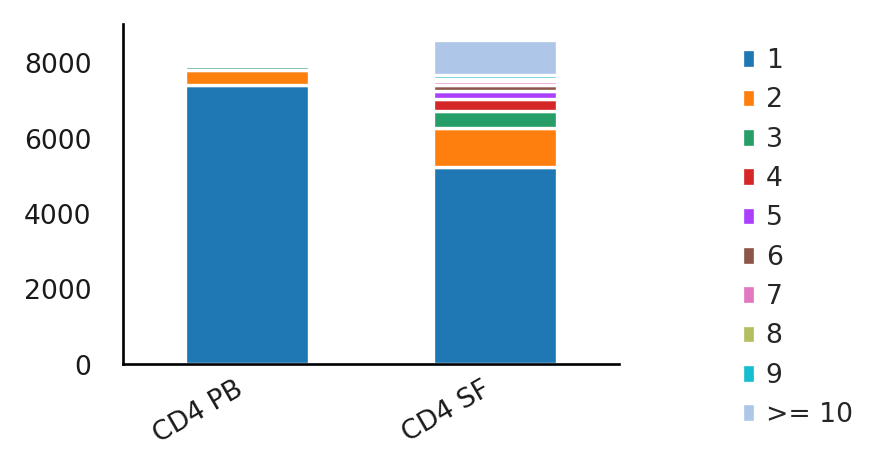

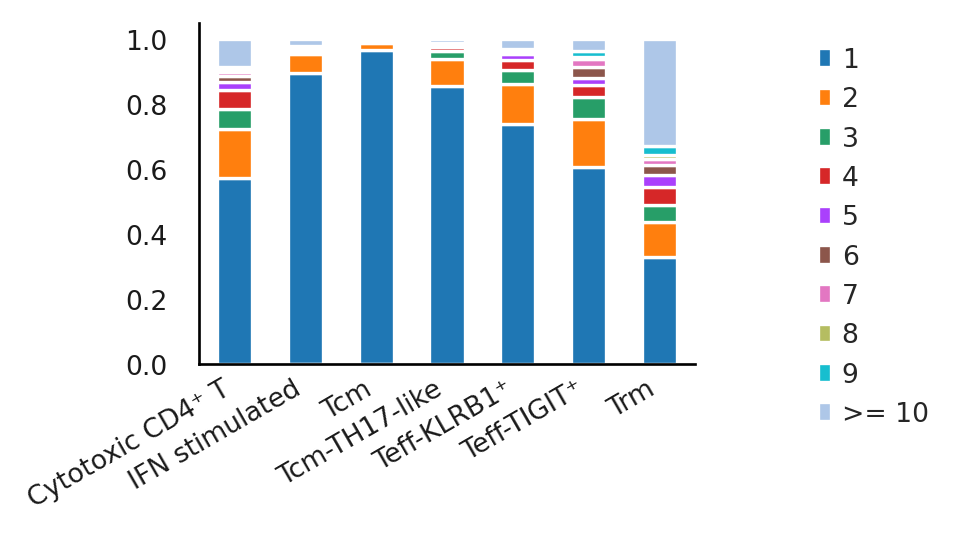

In [55]:
ir.pl.clonal_expansion(mnn_corrected_ent, groupby="cell type/sample", clip_at=10, normalize=False)
ir.pl.clonal_expansion(mnn_corrected_ent, groupby="Cell_types", clip_at=10, normalize=True)

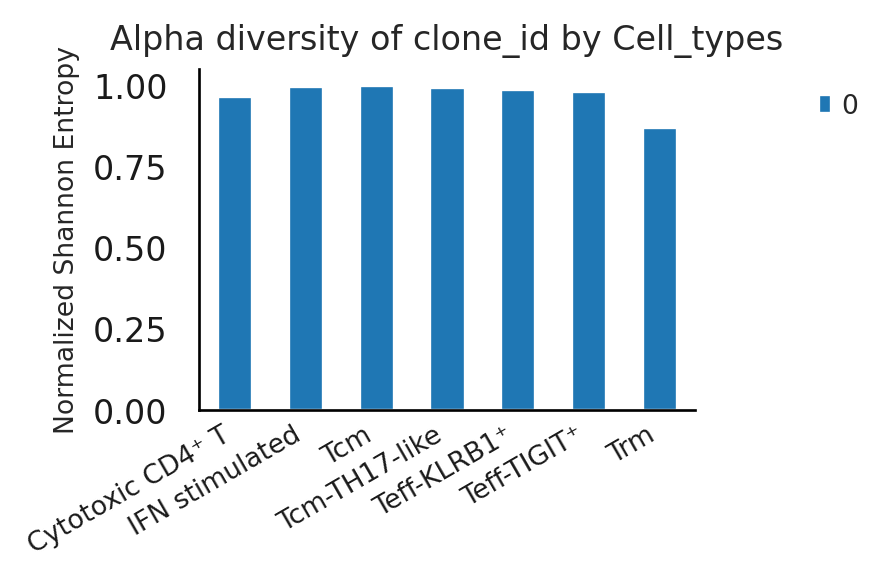

In [56]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=10, vector_friendly=False, format='png')
ax = ir.pl.alpha_diversity(mnn_corrected_ent, metric="normalized_shannon_entropy", groupby="Cell_types")

Interestingly, among the seven identified cluster, the Trm cluster showed the highest proportion of clonally expanded cells and, consistent with this observation, it had the lowest alpha diversity of clone types, suggesting a positive selection for certain, reactive T-cell clones.

<AxesSubplot:>

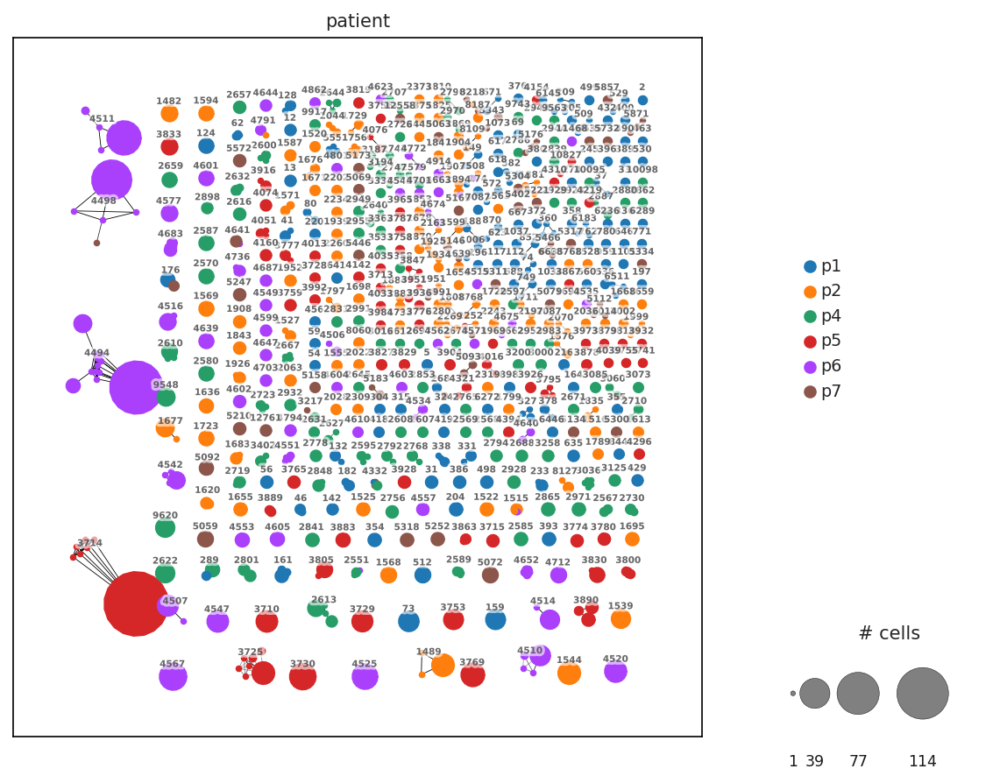

In [57]:
ir.pl.clonotype_network(mnn_corrected_ent, color="patient", label_fontsize=5, panel_size=(7, 7), base_size=7)

Above, network clustering of CD4+ T cells clones based on TCR sequence similarities. For each clones, the size of the dot is proportional to the percentage of cells with the same TCR, and the color code illustrates from which patient the clone belongs. This result suggests that the majority of clonotypes were private singletons.

## 9. Trajectory analysis

As our data set contains differentiation processes, we can investigate the differentiation trajectories in the data. This analysis is centred around the concept of 'pseudotime'. In pseudotime analysis a latent variable is inferred based on which the cells are ordered. This latent variable is supposed to measure the differentiation state along a trajectory. 

In order to proceed with this analysis, we first regress out (```sc.pp.regress_out```) the cell-cycle effect which can confound calculations, and than recalculate the dimensionality reduction methods such as PCA, and diffusion maps, as the variability of the subsetted data set will be projected onto different basis vectors.

To infer the trajectories, we used Slingshot, an R library. To move the python object into the R environment, it must be edited removing some layers and observation fields.

In [58]:
cluster_colors = mnn_corrected_ent.uns['louvain_r0.7_colors']
mnn_corrected_ent_1 = mnn_corrected_ent.copy()
sc.pp.regress_out(mnn_corrected_ent_1, ['S_score', 'G2M_score'])
calculate_visulizations(mnn_corrected_ent_1, th=150)
# Python object editing
mnn_corrected_ent_1.uns['neighbors']['connectivities'] = mnn_corrected_ent_1.obsp['connectivities']
mnn_corrected_ent_1.uns['neighbors']['distances'] = mnn_corrected_ent_1.obsp['distances']
if scipy.sparse.issparse(mnn_corrected_ent_1.obsp['connectivities']):
    if not mnn_corrected_ent_1.obsp['connectivities'].has_sorted_indices:
        mnn_corrected_ent_1.obsp['connectivities'].sort_indices()
del mnn_corrected_ent_1.uns
del mnn_corrected_ent_1.varm
mnn_corrected_ent_1.obs = mnn_corrected_ent_1.obs[['percent_mito',  'cell_type', 'patient', 'Cell_types', 'sample_type','pm_only','phase','louvain_r0.7','ribo_scaled', 'REACTOME_TCR_SIGNALING_score', 'NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score','REACTOME_CELL_CYCLE_score', 'TRM_CELLS_UP_score']]
mnn_corrected_ent_1.var = mnn_corrected_ent_1.var[['highly_variable']]
del mnn_corrected_ent_1.obsm['X_diffmap']
del mnn_corrected_ent_1.obsm['X_pca']
del mnn_corrected_ent_1.obsm['X_tsne']
del mnn_corrected_ent_1.obsm['X_clonotype_network']

In [59]:
mnn_corrected_ent_1.uns['Cell_types_colors'] = ['#8c564b','#e377c2','#1f77b4','#ff7f0e','#279e68','#aa40fc','#d62728']
cluster_colors = ['#8c564b','#e377c2','#1f77b4','#ff7f0e','#279e68','#aa40fc','#d62728']

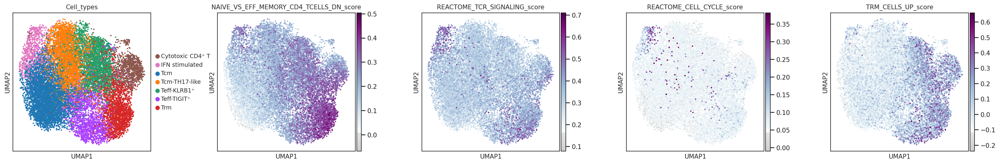

In [60]:
sc.pl.umap(mnn_corrected_ent_1, color=['Cell_types', 'NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score', 'REACTOME_TCR_SIGNALING_score', 'REACTOME_CELL_CYCLE_score', 'TRM_CELLS_UP_score'], use_raw=False, cmap=mymap, s=20, ncols=5, wspace=0.35)

Above, the UMAP rapresentation of cell-cycle effect free dataset. Below, we edit again the python object, after the new calculations, to prepare it for Slingshot run.

In [61]:
mnn_corrected_ent_1.obs[mnn_corrected_ent_1.obs.select_dtypes(np.float64).columns] = mnn_corrected_ent_1.obs.select_dtypes(np.float64).astype(np.float32)
del mnn_corrected_ent_1.uns
del mnn_corrected_ent_1.layers

#### Slingshot

In [62]:
%%R -i mnn_corrected_ent_1 -i cluster_colors
par(xpd=TRUE)
print("1:")
mnn_corrected_ent_1_start <- slingshot(mnn_corrected_ent_1, clusterLabels = 'Cell_types', reducedDim = 'UMAP', start.clus='Tcm', stretch = 0, shrink=0.8, extend='n')
print(SlingshotDataSet(mnn_corrected_ent_1_start))

print("2:")
mnn_corrected_ent_1_startend <- slingshot(mnn_corrected_ent_1, clusterLabels = 'Cell_types', reducedDim = 'UMAP', start.clus='Tcm', end.clus=c('Trm'))
print(SlingshotDataSet(mnn_corrected_ent_1_startend))

[1] "1:"
class: SlingshotDataSet 

 Samples Dimensions
   16724          2

lineages: 2 
Lineage1: Tcm  IFN stimulated  Tcm-TH17-like  Teff-KLRB1⁺  Cytotoxic CD4⁺ T  Trm  
Lineage2: Tcm  IFN stimulated  Tcm-TH17-like  Teff-KLRB1⁺  Teff-TIGIT⁺  

curves: 2 
Curve1: Length: 15.537	Samples: 13879.1
Curve2: Length: 14.529	Samples: 12924.65
[1] "2:"
class: SlingshotDataSet 

 Samples Dimensions
   16724          2

lineages: 2 
Lineage1: Tcm  IFN stimulated  Tcm-TH17-like  Teff-KLRB1⁺  Cytotoxic CD4⁺ T  Trm  
Lineage2: Tcm  IFN stimulated  Tcm-TH17-like  Teff-KLRB1⁺  Teff-TIGIT⁺  

curves: 2 
Curve1: Length: 23.031	Samples: 13979.23
Curve2: Length: 20.278	Samples: 12402.51


Here we output two inferred sets of trajectories. The inferred trajectories can be seen in the 'lineages:' output. In the first trajectory, no endpoints are fixed and only the 'Tcm' cell compartment is fixed as a starting point and the second trajectory includes Trm as endpoint.

The inferred trajectories show that even without a fixed endpoint the algorithm gives the same results, suggesting a consistent calculation.

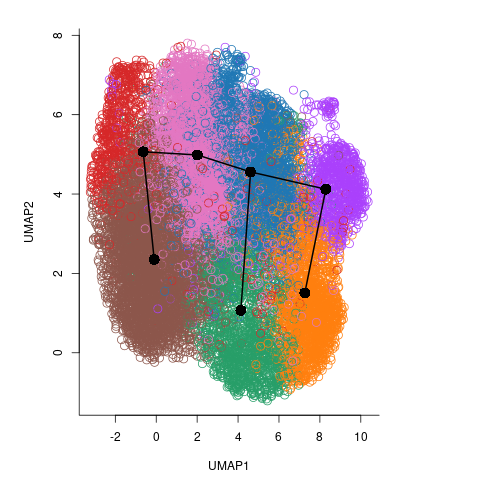

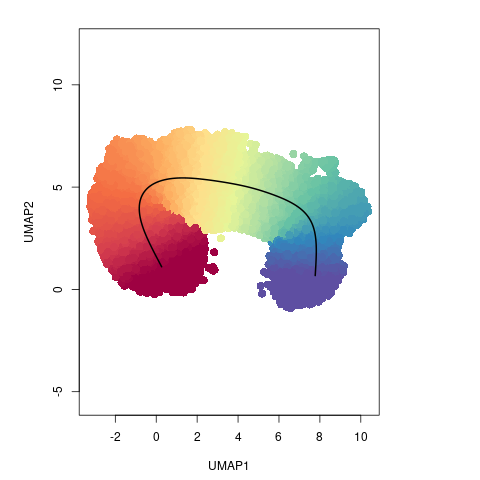

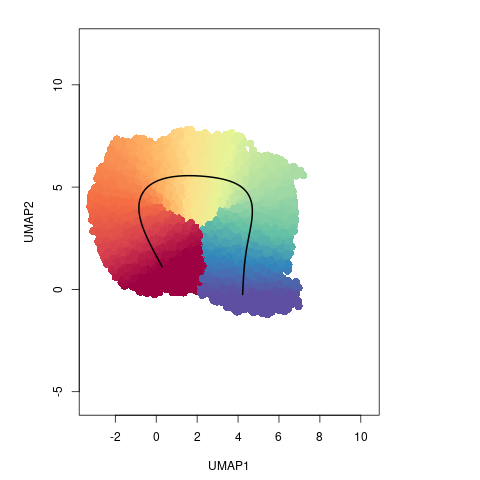

In [63]:
%%R
par(xpd=TRUE)
par(mar=c(4.5,5.5,2,7))
plot(reducedDims(mnn_corrected_ent_1)$UMAP[,1], reducedDims(mnn_corrected_ent_1)$UMAP[,2], col=unlist(cluster_colors[mnn_corrected_ent_1$louvain_r0.7]), bty='L', cex=1.5, xlab='UMAP1', ylab='UMAP2')
lines(SlingshotDataSet(mnn_corrected_ent_1_start), lwd=2, type='lineages')
legend(x=12, y=12, legend=sort(unique(colData(mnn_corrected_ent_1)$louvain_r0.7)), fill=unlist(cluster_colors))

colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)
plot(reducedDims(mnn_corrected_ent_1_start)$UMAP[,c(1,2)], col = colors[cut(mnn_corrected_ent_1_start$slingPseudotime_1,breaks=100)], pch=16, cex=1.5,, asp = 1, xlab='UMAP1', ylab='UMAP2')
lines(slingCurves(mnn_corrected_ent_1_start)$Lineage1, lwd=2)

plot(reducedDims(mnn_corrected_ent_1_start)$UMAP[,c(1,2)], col = colors[cut(mnn_corrected_ent_1_start$slingPseudotime_2,breaks=100)], pch=16, cex=1.5,, asp = 1, xlab='UMAP1', ylab='UMAP2')
lines(slingCurves(mnn_corrected_ent_1_start)$Lineage2, lwd=2)

Here we show the two inferred trajectoryes colouring cells by pseudotimes.

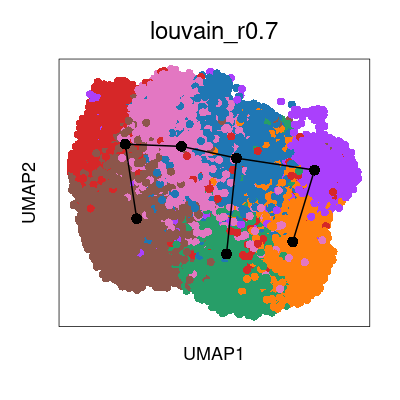

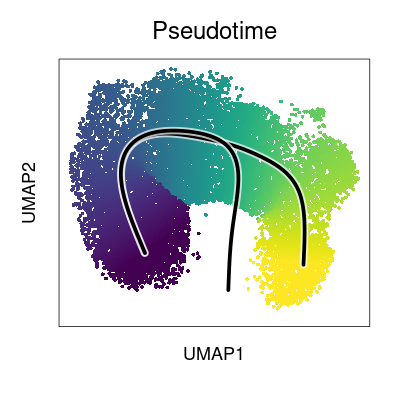

In [64]:
%%R -w 400 -h 400 -o trajs1 -o trajs2
library('viridis')
forvals <- function(val_vec){
  half <- round(max(val_vec))/2
  top <- round(max(val_vec))
  bot <- round(min(val_vec))
  low <- half/2
  high <- half+low
  c(bot, low, half, high, top)
}
trajs1 <- slingCurves(mnn_corrected_ent_1_start)$Lineage1$s
trajs2 <- slingCurves(mnn_corrected_ent_1_start)$Lineage2$s
plot(reducedDims(mnn_corrected_ent_1_start)$UMAP[,c(1,2)], col = unlist(cluster_colors[mnn_corrected_ent_1$louvain_r0.7]), pch=16, cex=1.5, xlab='', ylab='', cex.axis=1.5, cex.lab=1.5, font.main = 1, cex.main=2, xaxt='n', yaxt='n', main='louvain_r0.7')
title(xlab="UMAP1", line=1.5, cex.lab=1.5)
title(ylab="UMAP2", line=1.5, cex.lab=1.5)
lines(SlingshotDataSet(mnn_corrected_ent_1_start), lwd=2, type='lineages')
plot(reducedDims(mnn_corrected_ent_1_start)$UMAP[,c(1,2)], col = viridis(256)[cut(mnn_corrected_ent_1_start$slingPseudotime_1,breaks=256)], xlab='', ylab='', pch=16, cex=0.7, cex.axis=1.5, cex.lab=1.5, cex.main=2, xaxt='n', yaxt='n', font.main = 1, main='Pseudotime')
title(xlab="UMAP1", line=1.5, cex.lab=1.5)
title(ylab="UMAP2", line=1.5, cex.lab=1.5)
lines(slingCurves(mnn_corrected_ent_1_start)$Lineage1, lwd=10, col='#ffffffb3')
lines(slingCurves(mnn_corrected_ent_1_start)$Lineage1, lwd=5, col='black')
lines(slingCurves(mnn_corrected_ent_1_start)$Lineage2, lwd=10, col='#ffffffb3')
lines(slingCurves(mnn_corrected_ent_1_start)$Lineage2, lwd=5, col='black')#

Here we outputs the trajectories data, in order to integrate them in the scanpy object.

In [65]:
x1 = pd.DataFrame(trajs1)[0]
y1 = pd.DataFrame(trajs1)[1]
x2 = pd.DataFrame(trajs2)[0]
y2 = pd.DataFrame(trajs2)[1]

Below, we add some observation features removed before trajectory analysis.

In [66]:
mnn_corrected_ent_1.obs['clonal_expansion'] = mnn_corrected_ent.obs['clonal_expansion']
mnn_corrected_ent_1.obs['clone_id_size'] = mnn_corrected_ent.obs['clone_id_size']
mnn_corrected_ent_1.obs['clone_id'] = mnn_corrected_ent.obs['clone_id']
mnn_corrected_ent_1.obs['clone_id'] = mnn_corrected_ent.obs['Cell_types']

In [67]:
mnn_corrected_ent_1.obs['log_clone_id_size'] = np.log(mnn_corrected_ent_1.obs['clone_id_size'])

Below, we overlay the inferred trajectories over UMAP representation, colouring by cell type.

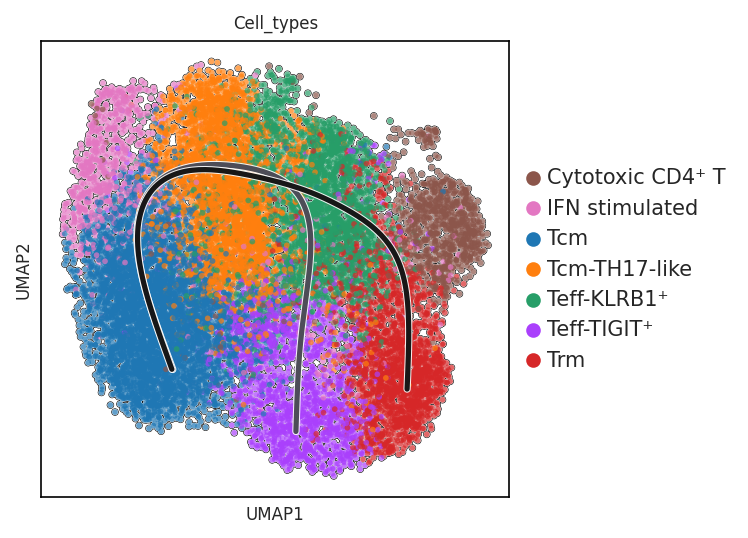

In [68]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=8, vector_friendly=False, format='png')
fig = plt.figure(figsize=(4,4))
gs = fig.add_gridspec(1,1)
for i,n in zip(['Cell_types'], range(1)):
    ax1 = fig.add_subplot(gs[0, n])
    sb.lineplot(x2,y2, ax=ax1, linewidth=3.5, legend=False, sort=False, color='white', alpha=0.9)
    sb.lineplot(x2,y2, ax=ax1, linewidth=2.5, legend=False, sort=False, color='#3B3B47', alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=3.5, legend=False, color='white', sort=False, alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=2.5, legend=False, color='black', sort=False, alpha=0.9)
    sc.pl.umap(mnn_corrected_ent_1, s=30, color = 'Cell_types', ax=ax1, palette=['#8c564b','#e377c2','#1f77b4','#ff7f0e','#279e68','#aa40fc','#d62728'], legend_loc='right margin', legend_fontsize=10, legend_fontoutline=0.8, outline_width=(0.1,0.05), add_outline=True)
plt.show()

Next, we do the same but coloring by log clone id size. Interestingly, both lineages, in particular lineage 1, end over the most clonally expanded populations.

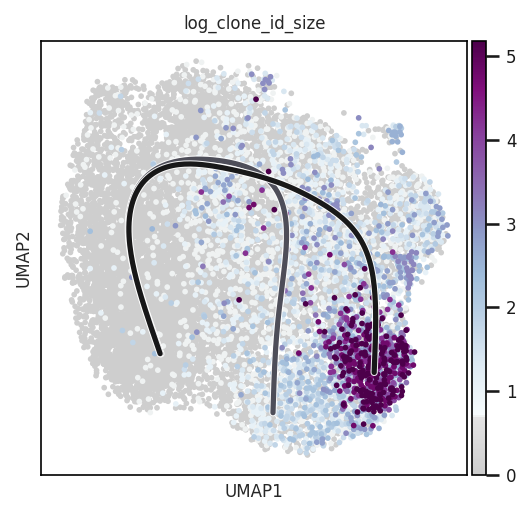

In [69]:
fig = plt.figure(figsize=(4,3.8))
gs = fig.add_gridspec(1,1, hspace=0.2, wspace=0.3)
for i,n,m in zip(['log_clone_id_size'], [0], [0]):
    ax1 = fig.add_subplot(gs[m, n])
    sc.pl.umap(mnn_corrected_ent_1, s=30, color = i, ax=ax1, cmap=mymap, show=False, title = i)
    sb.lineplot(x2,y2, ax=ax1, linewidth=3.5, legend=False, sort=False, color='white', alpha=0.9)
    sb.lineplot(x2,y2, ax=ax1, linewidth=2.5, legend=False, sort=False, color='#3B3B47', alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=3.5, legend=False, color='white', sort=False, alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=2.5, legend=False, color='black', sort=False, alpha=0.9)

We also evaluated the activation of cytotoxic functions along both trajectories. 

In [70]:
mnn_corrected_ent_1.layers['norm_log2_counts'] = mnn_corrected_ent.layers['norm_log2_counts']

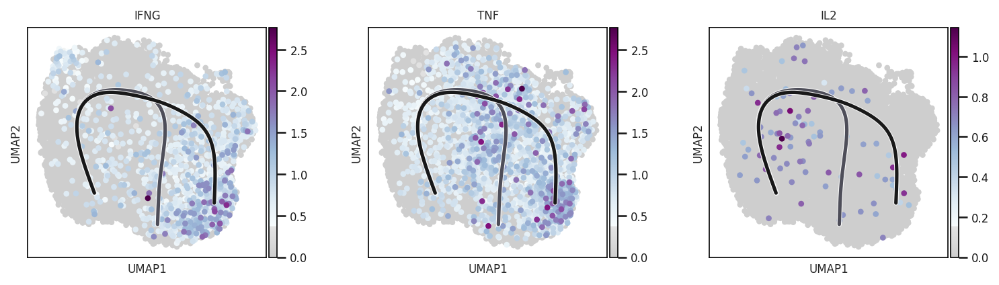

In [71]:
components = '1,2'
components = components.split(',')
components = np.array(components).astype(int) - 1
fig = plt.figure(figsize=(12,3))
gs = fig.add_gridspec(1,3, hspace=0.2, wspace=0.3)
for i,n in zip(['IFNG', 'TNF', 'IL2'], range(4)):
    ax1 = fig.add_subplot(gs[0, n])    
    sc.pl.umap(mnn_corrected_ent_1, s=70, color = i, ax=ax1, legend_loc = None, show=False, color_map=mymap, alpha = 1, title = i)
    sb.lineplot(x2,y2, ax=ax1, linewidth=3.5, legend=False, sort=False, color='white', alpha=0.9)
    sb.lineplot(x2,y2, ax=ax1, linewidth=2.5, legend=False, sort=False, color='#3B3B47', alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=3.5, legend=False, color='white', sort=False, alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=2.5, legend=False, color='black', sort=False, alpha=0.9)
plt.show()

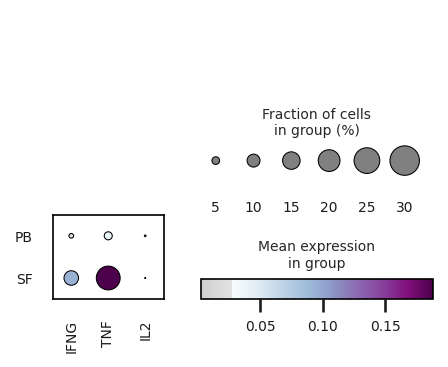

In [72]:
dp = sc.pl.dotplot(mnn_corrected_ent_1, ['IFNG', 'TNF', 'IL2'], groupby='sample_type', dendrogram=True, layer='norm_log2_counts', return_fig=True)#vmax=2,standard_scale='var',
dp.swap_axes(swap_axes=False)\
    .style(cmap=mymap, color_on='round', dot_edge_color='black', dot_edge_lw=0.5)\
    .legend(width=2.2)\
    .show()
rcParams['patch.edgecolor']= 'white'

Interestingly, we observed a decline in cytotoxic genes levels through lineage 2, while they increased along lineage 1. Next, we did the same for TIGIT and PDCD1, due to the high expression observed in terminal clusters.

To do this, we looked for cells expressing PDCD1 and TIGIT exclusively or in combination and we annotated them as “both expressed” if the expression of both genes was co-occurent over a defined treshold (0.5), “Neither expressed” if was under for both, “TIGIT not PDCD1” and “PDCD1 not TIGIT” if only one gene passed the threshold.

Next, as for Th1 and Th17 signatures we calculated their distribution density through the ```tl.embedding_density``` scanpy function.

In [73]:
def plot_2_genes(gene1, gene2):
    pairs_d = {(True, True): "Both expressed",
               (True, False): f"{gene1} not {gene2}",
               (False, True): f"{gene2} not {gene1}",
               (False, False): 'Neither expressed'}
    mnn_corrected_ent_1.obs[f"{gene1}_{gene2}"] = [pairs_d[x] for x in zip((mnn_corrected_ent_1[:, gene1].layers['norm_log2_counts'].todense().flatten() > 0.5).tolist()[0], (mnn_corrected_ent_1[:, gene2].layers['norm_log2_counts'].todense().flatten() > 0.5).tolist()[0])]
plot_2_genes('PDCD1', 'TIGIT')
sc.tl.embedding_density(mnn_corrected_ent_1, basis='umap', groupby='PDCD1_TIGIT')

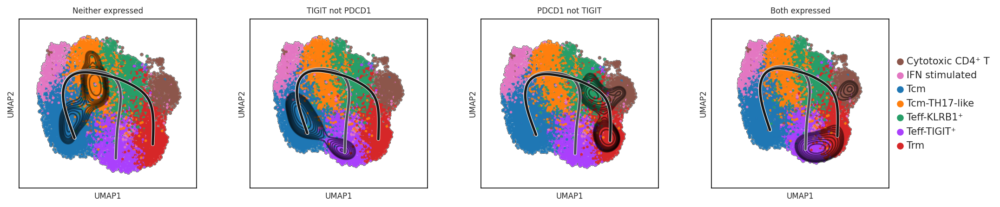

In [74]:
components = '1,2'
components = components.split(',')
components = np.array(components).astype(int) - 1
fig = plt.figure(figsize=(16,3.2))
gs = fig.add_gridspec(1,4, hspace=0.2, wspace=0.3)
for i,n in zip(['Neither expressed', 'TIGIT not PDCD1', 'PDCD1 not TIGIT', 'Both expressed'], range(4)):
    loca = None
    if n == 3:
        loca='right margin'
    ax1 = fig.add_subplot(gs[0, n])    
    cat_mask = mnn_corrected_ent_1.obs['PDCD1_TIGIT'] == i
    embed_x = mnn_corrected_ent_1.obsm[f'X_umap'][cat_mask, components[0]]
    embed_y = mnn_corrected_ent_1.obsm[f'X_umap'][cat_mask, components[1]]
    sc.pl.umap(mnn_corrected_ent_1, s=30, color = 'Cell_types', ax=ax1, legend_loc = loca, show=False, alpha = 0.9, title = i, legend_fontsize=10, legend_fontoutline=0.8, outline_width=(0.1,0.05), add_outline=True)
    sb.kdeplot(x=embed_x, y=embed_y, ax=ax1, color = '#00000080',thresh=0.7)
    sb.lineplot(x2,y2, ax=ax1, linewidth=3.5, legend=False, sort=False, color='white', alpha=0.9)
    sb.lineplot(x2,y2, ax=ax1, linewidth=2.5, legend=False, sort=False, color='#3B3B47', alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=3.5, legend=False, color='white', sort=False, alpha=0.9)
    sb.lineplot(x1,y1, ax=ax1, linewidth=2.5, legend=False, color='black', sort=False, alpha=0.9)
plt.show()

These plots show an increased expression of TIGIT alone or co-expressed with PDCD1 in terminal cluster Teff-TIGIT+. On the contrary, lineage 1 was mainly characterized by PDCD1 expression, reaching the highest levels in terminal clusters Cytotoxic CD4+ T and Trm.

In order to better characterize events along trejctories we calculated the metastable states.

In [75]:
cluster_colors = mnn_corrected_ent_1.uns['Cell_types_colors']

In [76]:
%%R -o pt1 -i cluster_colors -o dominant_clusters -o bin_width -o filler -o max_bin -o df

pt1 <- mnn_corrected_ent_1_start$slingPseudotime_1
clustDat <- mnn_corrected_ent_1_start$Cell_types

#Subset data to only include cells on lineage 1
clustDat <- clustDat[!is.na(pt1)]
pt1 <- pt1[!is.na(pt1)]
df = data.frame(clusters = clustDat, pt = pt1)

#Bin clusters in same way as pseudotime:
bin_width = 0.5
max_bin = ceiling(max(df$pt)*2)/2
df['bins'] = cut(df$pt, breaks=seq(-bin_width/2, max_bin, bin_width))

#Find dominant cluster in each bin
Mode <- function(x) {
  x<-x[!is.na(x)] 
  ux <- unique(x)
  ux[which.max(tabulate(match(x, ux)))]
}

dominant_clusters = sapply(levels(df$bins), function(x){Mode(df$clust[df$bins==x])})
levels(dominant_clusters) <- c(levels(dominant_clusters), 'None')
dominant_clusters[is.na(dominant_clusters)] <- 'None'

#Define colour map
cmap <- unlist(cluster_colors)
filler = I(cmap[dominant_clusters])
#Plot meta-stable states
p <- qplot(mnn_corrected_ent_1_start$slingPseudotime_1, geom='histogram', main='Cellular density over trajectory', xlab='Pseudotime', binwidth=bin_width) +
theme_bw()

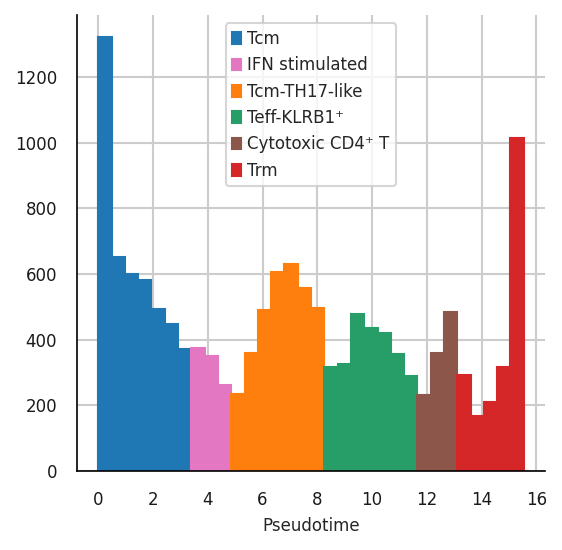

In [77]:
from matplotlib.patches import Rectangle
N, bins, patches = plt.hist(pt1, len(filler), histtype='bar')
for x in pd.Series(filler).drop_duplicates().to_list():
    if x.startswith('#'):
        idxs = np.where(np.array(filler)==x)[0].tolist()
        for i in idxs:
            patches[i].set_color(x)
    else:
        for i in idxs:
            patches[i].set_visible(False)
handles = [Rectangle((0,0),1,1, color=c) for c in [mnn_corrected_ent_1.uns['Cell_types_colors'][xx] for xx in list(map(int,[xz for xz in list((pd.Series(dominant_clusters).drop_duplicates()-1).tolist()) if xz != 'None']))]]
labels= [mnn_corrected_ent_1.obs['Cell_types'].cat.categories.tolist()[xx] for xx in list(map(int,[xz for xz in list((pd.Series(dominant_clusters).drop_duplicates()-1).tolist()) if xz != 'None']))]
plt.legend(handles, labels, prop={'size': 8})
plt.xlabel("Pseudotime", fontsize=8)  
plt.ylabel("", fontsize=8)
plt.xticks(fontsize=8)  
plt.yticks(fontsize=8)
ax = plt.subplot(111)  
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
plt.show()

Below we calculate the CTL distribution to observe it along trajectories.

In [78]:
for l in REACTOME_TCR_SIGNALING.keys():
    sc.tl.score_genes(mnn_corrected_ent_1, ['GZMA','PRF1'], ctrl_size=2, score_name='CTL_score', use_raw=True)

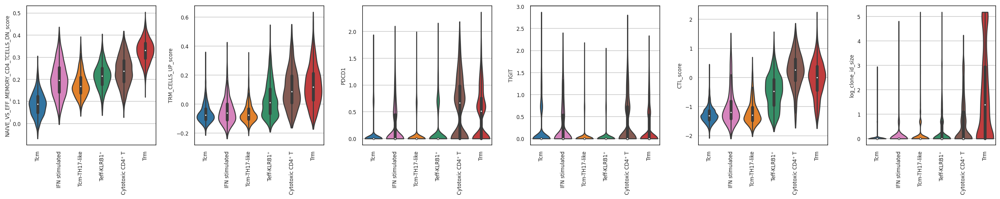

In [79]:
sc.pl.violin(mnn_corrected_ent_1, keys=['NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score', 'TRM_CELLS_UP_score','PDCD1', 'TIGIT', 'CTL_score', 'log_clone_id_size'], order=['Tcm', 'IFN stimulated', 'Tcm-TH17-like', 'Teff-KLRB1'+'\u207a', 'Cytotoxic CD4'+'\u207a'+' T', 'Trm'], groupby='Cell_types',stripplot=False, inner='box', rotation=90)

Next, we did the same for the other lineage.

In [80]:
%%R -o pt1 -i cluster_colors -o dominant_clusters -o bin_width -o filler -o max_bin -o df

pt1 <- mnn_corrected_ent_1_start$slingPseudotime_2
clustDat <- mnn_corrected_ent_1_start$Cell_types

#Subset data to only include cells on lineage 1
clustDat <- clustDat[!is.na(pt1)]
pt1 <- pt1[!is.na(pt1)]
df = data.frame(clusters = clustDat, pt = pt1)

#Bin clusters in same way as pseudotime:
bin_width = 0.5
max_bin = ceiling(max(df$pt)*2)/2
df['bins'] = cut(df$pt, breaks=seq(-bin_width/2, max_bin, bin_width))

#Find dominant cluster in each bin
Mode <- function(x) {
  x<-x[!is.na(x)] 
  ux <- unique(x)
  ux[which.max(tabulate(match(x, ux)))]
}

dominant_clusters = sapply(levels(df$bins), function(x){Mode(df$clust[df$bins==x])})
levels(dominant_clusters) <- c(levels(dominant_clusters), 'None')
dominant_clusters[is.na(dominant_clusters)] <- 'None'

#Define colour map
cmap <- unlist(cluster_colors)
filler = I(cmap[dominant_clusters])
#Plot meta-stable states
p <- qplot(mnn_corrected_ent_1_start$slingPseudotime_2, geom='histogram', main='Cellular density over trajectory', xlab='Pseudotime', binwidth=bin_width) +
theme_bw()

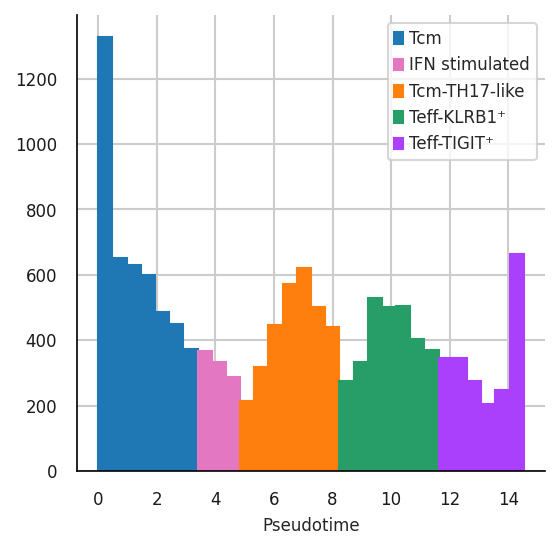

In [81]:
from matplotlib.patches import Rectangle
N, bins, patches = plt.hist(pt1, len(filler), histtype='bar')
for x in pd.Series(filler).drop_duplicates().to_list():
    if x.startswith('#'):
        idxs = np.where(np.array(filler)==x)[0].tolist()
        for i in idxs:
            patches[i].set_color(x)
    else:
        for i in idxs:
            patches[i].set_visible(False)
handles = [Rectangle((0,0),1,1, color=c) for c in [mnn_corrected_ent_1.uns['Cell_types_colors'][xx] for xx in list(map(int,[xz for xz in list((pd.Series(dominant_clusters).drop_duplicates()-1).tolist()) if xz != 'None']))]]
labels= [mnn_corrected_ent_1.obs['Cell_types'].cat.categories.tolist()[xx] for xx in list(map(int,[xz for xz in list((pd.Series(dominant_clusters).drop_duplicates()-1).tolist()) if xz != 'None']))]
plt.legend(handles, labels, prop={'size': 8})
plt.xlabel("Pseudotime", fontsize=8)  
plt.ylabel("", fontsize=8)
plt.xticks(fontsize=8)  
plt.yticks(fontsize=8)
ax = plt.subplot(111)  
ax.spines["top"].set_visible(False)  
ax.spines["right"].set_visible(False)
plt.show()

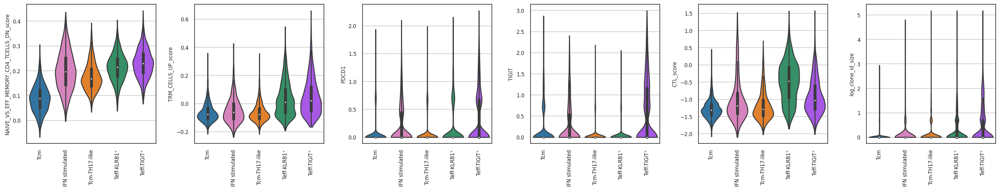

In [82]:
sc.pl.violin(mnn_corrected_ent_1, keys=['NAIVE_VS_EFF_MEMORY_CD4_TCELLS_DN_score', 'TRM_CELLS_UP_score','PDCD1', 'TIGIT', 'CTL_score', 'log_clone_id_size'], order=['Tcm', 'IFN stimulated', 'Tcm-TH17-like', 'Teff-KLRB1'+'\u207a', 'Teff-TIGIT'+'\u207a'], groupby='Cell_types',stripplot=False, inner='box', rotation=90, ncols=2, swap_axes = True)

Finally, we evaluated clonal expansion along pseudotime to understand if the two trajectories identified represent mutually exclusive lineages or alternatively can evolve one in the other. 

To this aim, we binned clones basing on clone-size intervals, keeping only clones with size > 5, we evaluated their expansion in each cluster and we plotted this information as a matrix showing the dataset clusters on an axis and the clone size bins on the other, in order to know the clone id, its size based on the belonging bin and its sharing level.

In [83]:
mnn_corrected_ent_1.obs['clone_id'] = mnn_corrected_ent.obs['clone_id']
mnn_corrected_ent_1.obs['clone_id_size_cat'] = mnn_corrected_ent_1.obs['clone_id_size'].astype('category')
mnn_corrected_ent_1.obs['clone_id_size_cat'] = mnn_corrected_ent_1.obs['clone_id_size_cat'].cat.add_categories('< 40')
mnn_corrected_ent_1.obs.loc[mnn_corrected_ent_1.obs['clone_id_size'] < 40, ['clone_id_size_cat']] = '< 40'
mnn_corrected_ent_1.obs['clone_id_size_cat'] = mnn_corrected_ent_1.obs['clone_id_size_cat'].cat.remove_unused_categories()

In [84]:
mnn_corrected_ent_1.uns['clone_id_size_cat_colors'] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b','#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', 'lightgray']

In [85]:
mnn_corrected_ent_1.obs['clone_id_size_bins'] = pd.cut(mnn_corrected_ent_1.obs['clone_id_size'], [0,5,10,20,30,40,50,60,70,80,90,100,150,200,250,300])

In [86]:
mnn_corrected_ent_1.obs['clone_id_size_bins'] = mnn_corrected_ent_1.obs['clone_id_size_bins'].cat.add_categories('Nan')
mnn_corrected_ent_1.obs['clone_id_size_bins'] = mnn_corrected_ent_1.obs['clone_id_size_bins'].fillna('Nan')

In [87]:
mnn_corrected_ent_1.obs['clone_id_size_bins_cat'] = [x.split(',')[1][1:-1] if x != 'Nan' else x for x in mnn_corrected_ent_1.obs['clone_id_size_bins'].astype('str').to_list()]

In [88]:
mnn_corrected_ent_1.uns['clone_id_size_bins_cat_colors'] = [dark_cols[i] for i in [10,11,12,13,14,5]]+['#1f77b4', '#ff7f0e', 'lightgray']

In [89]:
clone_tab = mnn_corrected_ent_1[mnn_corrected_ent_1.obs['clone_id_size']>=5].obs[['Cell_types', 'clone_id', 'clone_id_size_bins_cat']].groupby(['Cell_types','clone_id_size_bins_cat', 'clone_id'], as_index=True).agg({'clone_id':['count']}).unstack(level=0, fill_value=0)#.to_excel('Clone_by_cluster.xlsx')
clone_tab = clone_tab.loc[~(clone_tab==0).all(axis=1)]
normalized_clone_tab=(clone_tab-clone_tab.min())/(clone_tab.max()-clone_tab.min())
normalized_clone_tab.columns = normalized_clone_tab.columns.droplevel([0,1])

In [90]:
final_index = []
ggg = normalized_clone_tab.groupby('clone_id_size_bins_cat')
for mm in ['5', '10', '20', '30', '40' ,'50' ,'70','150' ,'200']:
    final_index.append(list(ggg.get_group(mm).sum(1).sort_values().index.values))

In [91]:
a = normalized_clone_tab.index.levels[0].astype(int)
b = normalized_clone_tab.index.levels[1]
normalized_clone_tab.index = normalized_clone_tab.index.set_levels([a,b])

In [92]:
normalized_clone_tab = normalized_clone_tab.sort_index()

In [93]:
network_lut = dict(zip(map(int,sorted(map(int,np.unique(normalized_clone_tab.index.get_level_values(0))))), ['#8dd3c7','#ffffb3','#bebada','#fb8072','#80b1d3','#fdb462','#b3de69','#fccde5','#bc80bd']))
network_labels = normalized_clone_tab.index.get_level_values(0)
network_colors = pd.Series(network_labels, index=normalized_clone_tab.index).map(network_lut)
network_colors.index = network_colors.index.set_names(['clone bin size','clone id'], level=[0,1])
network_colors.name = 'clone bin size'
columncols = dict(zip(mnn_corrected_ent_1.obs['Cell_types'].cat.categories.tolist(),mnn_corrected_ent_1.uns['Cell_types_colors']))
colcolors = pd.Series(normalized_clone_tab.columns, index=normalized_clone_tab.columns).map(columncols)
normalized_clone_tab.index = normalized_clone_tab.index.set_names(['clone bin size','clone id'], level=[0,1])
colcolors.name = 'cluster'

Text(581.9154411764706, 0.5, 'normalized counts')

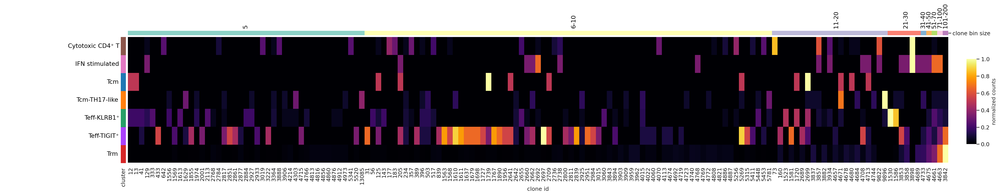

In [94]:
sc.set_figure_params(dpi=75, dpi_save=300, fontsize=12, vector_friendly=False, figsize=(4,4))
g = sb.clustermap(normalized_clone_tab.T,col_cluster=False, row_cluster=False,col_colors=network_colors,row_colors=colcolors,linewidths=0.0, yticklabels=False, xticklabels=normalized_clone_tab.index.droplevel(0).tolist(),dendrogram_ratio=(.1, .1),figsize=(30,5.7), cmap='inferno')
add=0
for label,kk in zip(colcolors.index.tolist(),[-10.6, -9.1, -2.8, -8.9, -7.3, -6.5, -2.8]):
    g.ax_row_colors.text(kk , 0.5+add, label, color='black', ha='left', va='center', rotation=0, fontsize=13,
                         transform=g.ax_row_colors.get_yaxis_transform())
    add+=1
sps = [-0.01,0.39,0.71,0.795,0.816,0.823,0.8295,0.8365, 0.843]
for label,add in zip(['5', '6-10', '11-20', '21-30', '31-40', '41-50', '51-70', '71-100', '101-200'],sps):
    g.ax_col_colors.text(0.15+add, -0.6, label, color='black', ha='left', va='bottom', rotation=90, fontsize=13,
                         transform=g.ax_col_colors.get_yaxis_transform())
g.ax_heatmap.set_xlabel('clone id')
g.ax_heatmap.set_ylabel('')
g.cax.set_position([.97, .285, .01, .45])
g.ax_row_colors.set_position([0.1236, 0.185, .005, .665])
g.ax_cbar.set_ylabel("normalized counts",size=11)

Notably, the most expanded clones were shared between trajectory terminal clusters Trm and Teff-TIGIT+. These observations suggest that CD4+ cells of different clusters might undergo state transitions upon proper microenvironmental stimulation.